In [ ]:
%load_ext autoreload
%autoreload 2

import sys
import os
import time

import numpy as np
try:
    import mxnet as mx
except:
    sys.stderr.write("Cannot import mxnet.\n")
import matplotlib.pyplot as plt
%matplotlib inline
from scipy.ndimage.interpolation import map_coordinates
from skimage.exposure import rescale_intensity
from skimage.transform import rotate

sys.path.append(os.environ['REPO_DIR'] + '/utilities')
from utilities2015 import *
from metadata import *
from data_manager import *
from learning_utilities import *
from distributed_utilities import *
from visualization_utilities import *

In [3]:
from sklearn.externals import joblib

from sklearn.linear_model import LogisticRegression
from sklearn.svm import LinearSVC, SVC
from sklearn.calibration import CalibratedClassifierCV
from sklearn.ensemble import GradientBoostingClassifier 

sys.path.append('/home/yuncong/csd395/xgboost/python-package')
try:
    from xgboost.sklearn import XGBClassifier
except:
    sys.stderr.write('xgboost is not loaded.')

# Compare Nissl and ChatCryoJane201710

In [57]:
for stack in ['MD589', 'MD585', 'MD594']:

    local_region_bboxes_all_sections = get_local_regions(stack, margin_um=200)['7N_L']

#     local_region_images = {}

    for sec, bbox in local_region_bboxes_all_sections.iteritems():
        if sec % 5 == 0:
            img = rgb2gray(DataManager.load_image_v2(stack=stack, prep_id=2, section=sec, version='jpeg'))
            img_local_region = img[bbox[2]:bbox[3]+1, bbox[0]:bbox[1]+1].copy()
#             local_region_images[sec] = img_local_region
            imsave(ROOT_DIR + '/image_examples/%s_%d_%s.jpg' % (stack, sec, '7N'), img_local_region)

aws s3 cp --recursive "s3://mousebrainatlas-data/CSHL_labelings_v3/MD589" "/home/yuncong/CSHL_labelings_v3/MD589" --exclude "*" --include "*contours*"
latest timestamp:  10042017100807


Not using image_cache.
/usr/local/lib/python2.7/dist-packages/skimage/util/dtype.py:110: UserWarning: Possible precision loss when converting from float64 to uint8
  "%s to %s" % (dtypeobj_in, dtypeobj))
Not using image_cache.
Not using image_cache.
Not using image_cache.
Not using image_cache.
Not using image_cache.
Not using image_cache.
Not using image_cache.
Not using image_cache.


aws s3 cp --recursive "s3://mousebrainatlas-data/CSHL_labelings_v3/MD585" "/home/yuncong/CSHL_labelings_v3/MD585" --exclude "*" --include "*contours*"
latest timestamp:  08012017212649


Not using image_cache.
Not using image_cache.
Not using image_cache.
Not using image_cache.
Not using image_cache.
Not using image_cache.
Not using image_cache.
Not using image_cache.
Not using image_cache.


aws s3 cp --recursive "s3://mousebrainatlas-data/CSHL_labelings_v3/MD594" "/home/yuncong/CSHL_labelings_v3/MD594" --exclude "*" --include "*contours*"
latest timestamp:  07302017183604


Not using image_cache.
Not using image_cache.
Not using image_cache.
Not using image_cache.
Not using image_cache.
Not using image_cache.
Not using image_cache.
Not using image_cache.
Not using image_cache.


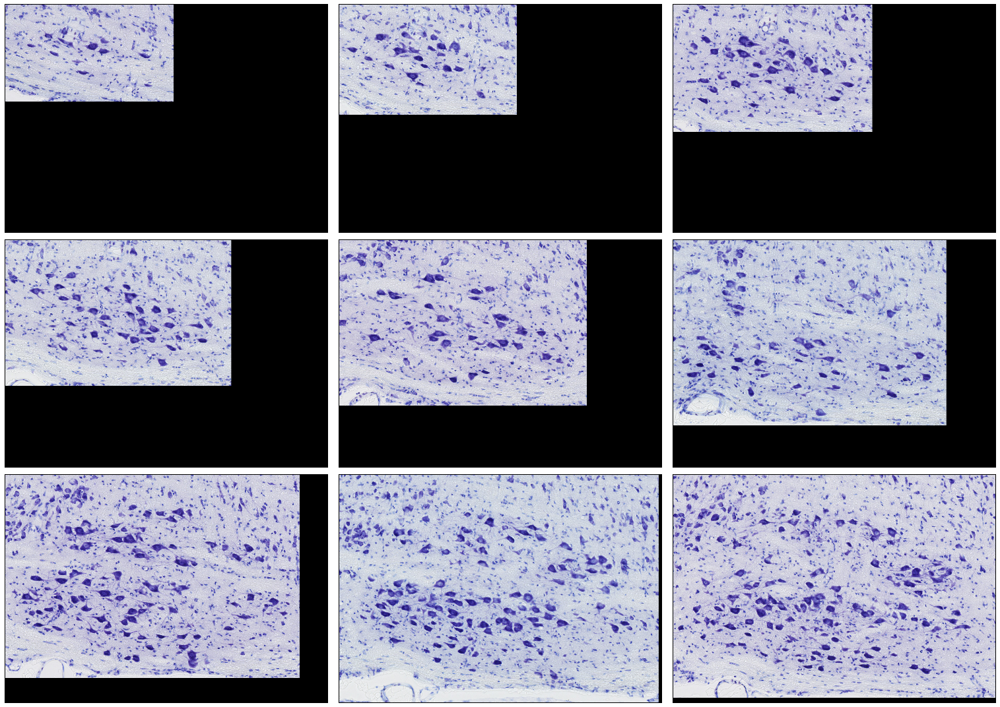

In [17]:
display_images_in_grids(local_region_images.values(), nc=3, cmap=plt.cm.gray, )

In [ ]:
for stack in ['MD595']:
    local_region_bboxes_all_sections = get_local_regions(stack, margin_um=200, by_human=False, level=0.5, 
                                                         structures=['7N_L'])
    for name_s, x in local_region_bboxes_all_sections.iteritems():
        for sec, bbox in x.iteritems():
            if sec % 5 == 0:
                img = rgb2gray(DataManager.load_image_v2(stack=stack, prep_id=2, section=sec, version='jpeg'))
                img_local_region = img[bbox[2]:bbox[3]+1, bbox[0]:bbox[1]+1].copy()

                viz_fp = ROOT_DIR + '/image_examples/%s_%d_%s.jpg' % (stack, sec, '7N')
                imsave(viz_fp, img_local_region)
                upload_to_s3(viz_fp)

In [ ]:
for stack in ['MD595']:
    local_region_bboxes_all_sections = get_local_regions(stack, margin_um=200, by_human=False, level=0.5, 
                                                         structures=['7N_L'])
    local_region_images = {}
    for name_s, x in local_region_bboxes_all_sections.iteritems():
        for sec, bbox in x.iteritems():
            if sec % 5 == 0:
                img = DataManager.load_image_v2(stack=stack, prep_id=2, section=sec, version='jpeg')
                img_local_region = img[bbox[2]:bbox[3]+1, bbox[0]:bbox[1]+1].copy()
                local_region_images[sec] = img_local_region

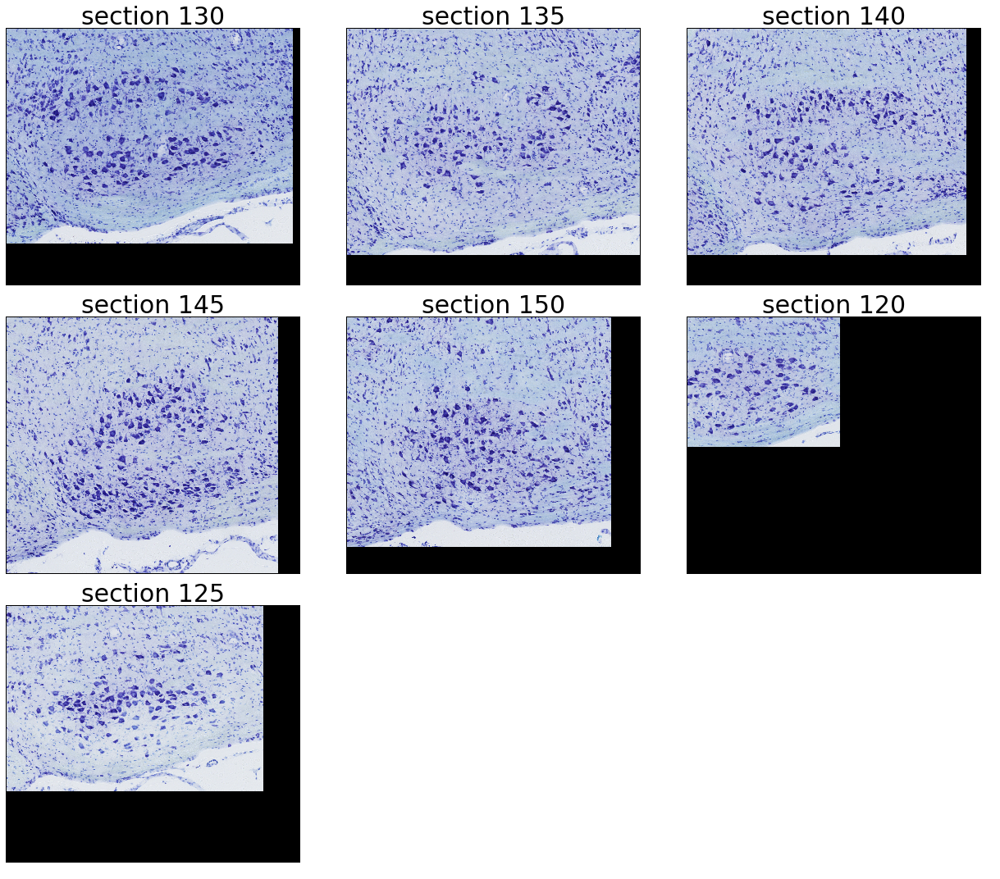

In [25]:
display_images_in_grids(local_region_images.values(), nc=3, cmap=plt.cm.gray, 
                        titles=['section %d' % sec for sec in local_region_images.keys()])

In [12]:
# for stack in ['MD653', 'MD652', 'MD642', 'MD657', 'MD658']:
for stack in ['MD658']:
    print stack
#     local_region_bboxes_all_sections = get_local_regions(stack, margin_um=200, by_human=False, level=0.5, 
#                                                          structures=['7N_L'],
#                                                         detector_id_f=13)
    local_region_bboxes_all_sections = get_local_regions(stack, margin_um=200, by_human=True, 
                                                         structures=['7N_L'])
    for name_s, x in local_region_bboxes_all_sections.iteritems():
        print name_s
        for sec, bbox in x.iteritems():
            if sec in metadata_cache['valid_sections'][stack] and sec % 1 == 0:
                print sec
                is_nissl = metadata_cache['sections_to_filenames'][stack][sec].split('-')[1].startswith('N')
                
                if is_nissl:
                    img = DataManager.load_image_v2(stack=stack, prep_id=2, section=sec, version='gray')
                    img_local_region = img[bbox[2]:bbox[3]+1, bbox[0]:bbox[1]+1].copy()
                    img_local_region_calib = (img_local_region - img_local_region.mean()) / img_local_region.std()
                    img_local_region = rescale_intensity_v2(img_local_region_calib, -6, 1)
                else:
                    img = DataManager.load_image_v2(stack=stack, prep_id=2, section=sec)[..., 2]
                    img_local_region = img[bbox[2]:bbox[3]+1, bbox[0]:bbox[1]+1].copy()
                    img_local_region_calib = (img_local_region - img_local_region.mean()) / img_local_region.std()
                    img_local_region = rescale_intensity_v2(img_local_region_calib, 6, -1)

                viz_fp = ROOT_DIR + '/image_examples/%s/%s_%d%s_%s.jpg' % (stack, stack, sec, 'N' if is_nissl else 'F', '7N')
                create_parent_dir_if_not_exists(viz_fp)
                imsave(viz_fp, img_local_region)
                upload_to_s3(viz_fp)

MD658
aws s3 cp --recursive "s3://mousebrainatlas-data/CSHL_labelings_v3/MD658" "/home/yuncong/CSHL_labelings_v3/MD658" --exclude "*" --include "*contours*"
latest timestamp:  01082018162524
LRt_R
Sp5C_L
Pn_L
7N_R
PBG_L
VLL_L
4N_R
VLL_R
7N_L
162


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD658/MD658_162N_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD658/MD658_162N_7N.jpg"
163


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD658/MD658_163F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD658/MD658_163F_7N.jpg"
164


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD658/MD658_164N_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD658/MD658_164N_7N.jpg"
165


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD658/MD658_165F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD658/MD658_165F_7N.jpg"
166


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD658/MD658_166N_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD658/MD658_166N_7N.jpg"
167


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD658/MD658_167F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD658/MD658_167F_7N.jpg"
168


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD658/MD658_168N_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD658/MD658_168N_7N.jpg"
169


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD658/MD658_169F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD658/MD658_169F_7N.jpg"
170


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD658/MD658_170N_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD658/MD658_170N_7N.jpg"
171


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD658/MD658_171F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD658/MD658_171F_7N.jpg"
172


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD658/MD658_172N_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD658/MD658_172N_7N.jpg"
173


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD658/MD658_173F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD658/MD658_173F_7N.jpg"
174


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD658/MD658_174N_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD658/MD658_174N_7N.jpg"
175


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD658/MD658_175F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD658/MD658_175F_7N.jpg"
176


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD658/MD658_176N_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD658/MD658_176N_7N.jpg"
177


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD658/MD658_177F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD658/MD658_177F_7N.jpg"
178


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD658/MD658_178N_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD658/MD658_178N_7N.jpg"
179


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD658/MD658_179F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD658/MD658_179F_7N.jpg"
180


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD658/MD658_180N_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD658/MD658_180N_7N.jpg"
181


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD658/MD658_181F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD658/MD658_181F_7N.jpg"
182
rm -rf "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD658/MD658_prep2_lossless_gray/MD658-N36-2017.03.31-18.40.37_MD658_2_0107_prep2_lossless_gray.tif" && mkdir -p "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD658/MD658_prep2_lossless_gray"
aws s3 cp "s3://mousebrainatlas-data/CSHL_data_processed/MD658/MD658_prep2_lossless_gray/MD658-N36-2017.03.31-18.40.37_MD658_2_0107_prep2_lossless_gray.tif" "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD658/MD658_prep2_lossless_gray/MD658-N36-2017.03.31-18.40.37_MD658_2_0107_prep2_lossless_gray.tif"


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD658/MD658_182N_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD658/MD658_182N_7N.jpg"
183


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD658/MD658_183F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD658/MD658_183F_7N.jpg"
185


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD658/MD658_185F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD658/MD658_185F_7N.jpg"
186
rm -rf "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD658/MD658_prep2_lossless_gray/MD658-N37-2017.03.31-18.44.15_MD658_2_0110_prep2_lossless_gray.tif" && mkdir -p "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD658/MD658_prep2_lossless_gray"
aws s3 cp "s3://mousebrainatlas-data/CSHL_data_processed/MD658/MD658_prep2_lossless_gray/MD658-N37-2017.03.31-18.44.15_MD658_2_0110_prep2_lossless_gray.tif" "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD658/MD658_prep2_lossless_gray/MD658-N37-2017.03.31-18.44.15_MD658_2_0110_prep2_lossless_gray.tif"


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD658/MD658_186N_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD658/MD658_186N_7N.jpg"
187


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD658/MD658_187F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD658/MD658_187F_7N.jpg"
188
rm -rf "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD658/MD658_prep2_lossless_gray/MD658-N38-2017.03.31-18.48.30_MD658_1_0112_prep2_lossless_gray.tif" && mkdir -p "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD658/MD658_prep2_lossless_gray"
aws s3 cp "s3://mousebrainatlas-data/CSHL_data_processed/MD658/MD658_prep2_lossless_gray/MD658-N38-2017.03.31-18.48.30_MD658_1_0112_prep2_lossless_gray.tif" "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD658/MD658_prep2_lossless_gray/MD658-N38-2017.03.31-18.48.30_MD658_1_0112_prep2_lossless_gray.tif"


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD658/MD658_188N_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD658/MD658_188N_7N.jpg"
189


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD658/MD658_189F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD658/MD658_189F_7N.jpg"
190
rm -rf "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD658/MD658_prep2_lossless_gray/MD658-N38-2017.03.31-18.48.30_MD658_2_0113_prep2_lossless_gray.tif" && mkdir -p "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD658/MD658_prep2_lossless_gray"
aws s3 cp "s3://mousebrainatlas-data/CSHL_data_processed/MD658/MD658_prep2_lossless_gray/MD658-N38-2017.03.31-18.48.30_MD658_2_0113_prep2_lossless_gray.tif" "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD658/MD658_prep2_lossless_gray/MD658-N38-2017.03.31-18.48.30_MD658_2_0113_prep2_lossless_gray.tif"


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD658/MD658_190N_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD658/MD658_190N_7N.jpg"
191


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD658/MD658_191F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD658/MD658_191F_7N.jpg"
192
rm -rf "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD658/MD658_prep2_lossless_gray/MD658-N39-2017.03.31-18.51.58_MD658_1_0115_prep2_lossless_gray.tif" && mkdir -p "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD658/MD658_prep2_lossless_gray"
aws s3 cp "s3://mousebrainatlas-data/CSHL_data_processed/MD658/MD658_prep2_lossless_gray/MD658-N39-2017.03.31-18.51.58_MD658_1_0115_prep2_lossless_gray.tif" "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD658/MD658_prep2_lossless_gray/MD658-N39-2017.03.31-18.51.58_MD658_1_0115_prep2_lossless_gray.tif"


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD658/MD658_192N_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD658/MD658_192N_7N.jpg"
193


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD658/MD658_193F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD658/MD658_193F_7N.jpg"
194
rm -rf "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD658/MD658_prep2_lossless_gray/MD658-N39-2017.03.31-18.51.58_MD658_2_0116_prep2_lossless_gray.tif" && mkdir -p "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD658/MD658_prep2_lossless_gray"
aws s3 cp "s3://mousebrainatlas-data/CSHL_data_processed/MD658/MD658_prep2_lossless_gray/MD658-N39-2017.03.31-18.51.58_MD658_2_0116_prep2_lossless_gray.tif" "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD658/MD658_prep2_lossless_gray/MD658-N39-2017.03.31-18.51.58_MD658_2_0116_prep2_lossless_gray.tif"


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD658/MD658_194N_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD658/MD658_194N_7N.jpg"
195


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD658/MD658_195F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD658/MD658_195F_7N.jpg"
196
rm -rf "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD658/MD658_prep2_lossless_gray/MD658-N40-2017.03.31-18.55.40_MD658_1_0118_prep2_lossless_gray.tif" && mkdir -p "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD658/MD658_prep2_lossless_gray"
aws s3 cp "s3://mousebrainatlas-data/CSHL_data_processed/MD658/MD658_prep2_lossless_gray/MD658-N40-2017.03.31-18.55.40_MD658_1_0118_prep2_lossless_gray.tif" "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD658/MD658_prep2_lossless_gray/MD658-N40-2017.03.31-18.55.40_MD658_1_0118_prep2_lossless_gray.tif"


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD658/MD658_196N_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD658/MD658_196N_7N.jpg"
197


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD658/MD658_197F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD658/MD658_197F_7N.jpg"
198
rm -rf "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD658/MD658_prep2_lossless_gray/MD658-N40-2017.03.31-18.55.40_MD658_2_0119_prep2_lossless_gray.tif" && mkdir -p "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD658/MD658_prep2_lossless_gray"
aws s3 cp "s3://mousebrainatlas-data/CSHL_data_processed/MD658/MD658_prep2_lossless_gray/MD658-N40-2017.03.31-18.55.40_MD658_2_0119_prep2_lossless_gray.tif" "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD658/MD658_prep2_lossless_gray/MD658-N40-2017.03.31-18.55.40_MD658_2_0119_prep2_lossless_gray.tif"


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD658/MD658_198N_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD658/MD658_198N_7N.jpg"
199


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD658/MD658_199F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD658/MD658_199F_7N.jpg"
200


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD658/MD658_200F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD658/MD658_200F_7N.jpg"
201
rm -rf "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD658/MD658_prep2_lossless_gray/MD658-N41-2017.03.31-18.59.32_MD658_2_0122_prep2_lossless_gray.tif" && mkdir -p "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD658/MD658_prep2_lossless_gray"
aws s3 cp "s3://mousebrainatlas-data/CSHL_data_processed/MD658/MD658_prep2_lossless_gray/MD658-N41-2017.03.31-18.59.32_MD658_2_0122_prep2_lossless_gray.tif" "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD658/MD658_prep2_lossless_gray/MD658-N41-2017.03.31-18.59.32_MD658_2_0122_prep2_lossless_gray.tif"


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD658/MD658_201N_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD658/MD658_201N_7N.jpg"
202


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD658/MD658_202F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD658/MD658_202F_7N.jpg"
203
rm -rf "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD658/MD658_prep2_lossless_gray/MD658-N42-2017.03.31-19.03.29_MD658_1_0124_prep2_lossless_gray.tif" && mkdir -p "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD658/MD658_prep2_lossless_gray"
aws s3 cp "s3://mousebrainatlas-data/CSHL_data_processed/MD658/MD658_prep2_lossless_gray/MD658-N42-2017.03.31-19.03.29_MD658_1_0124_prep2_lossless_gray.tif" "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD658/MD658_prep2_lossless_gray/MD658-N42-2017.03.31-19.03.29_MD658_1_0124_prep2_lossless_gray.tif"


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD658/MD658_203N_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD658/MD658_203N_7N.jpg"
204


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD658/MD658_204F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD658/MD658_204F_7N.jpg"
205
rm -rf "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD658/MD658_prep2_lossless_gray/MD658-N42-2017.03.31-19.03.29_MD658_2_0125_prep2_lossless_gray.tif" && mkdir -p "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD658/MD658_prep2_lossless_gray"
aws s3 cp "s3://mousebrainatlas-data/CSHL_data_processed/MD658/MD658_prep2_lossless_gray/MD658-N42-2017.03.31-19.03.29_MD658_2_0125_prep2_lossless_gray.tif" "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD658/MD658_prep2_lossless_gray/MD658-N42-2017.03.31-19.03.29_MD658_2_0125_prep2_lossless_gray.tif"


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD658/MD658_205N_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD658/MD658_205N_7N.jpg"
206


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD658/MD658_206F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD658/MD658_206F_7N.jpg"
207
rm -rf "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD658/MD658_prep2_lossless_gray/MD658-N43-2017.03.31-19.07.08_MD658_1_0127_prep2_lossless_gray.tif" && mkdir -p "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD658/MD658_prep2_lossless_gray"
aws s3 cp "s3://mousebrainatlas-data/CSHL_data_processed/MD658/MD658_prep2_lossless_gray/MD658-N43-2017.03.31-19.07.08_MD658_1_0127_prep2_lossless_gray.tif" "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD658/MD658_prep2_lossless_gray/MD658-N43-2017.03.31-19.07.08_MD658_1_0127_prep2_lossless_gray.tif"


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD658/MD658_207N_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD658/MD658_207N_7N.jpg"
PBG_R
RtTg
Sp5C_R
Pn_R
LRt_L
Sp5O_R
SNR_L
12N
SNR_R
Sp5O_L
DC_R
VCA_L
3N_L
6N_R
Sp5I_L
RMC_R
5N_L
SNC_L
SNC_R
AP
RMC_L
Sp5I_R
3N_R
6N_L
IC
VCA_R
DC_L
Amb_R
VCP_R
LC_R
10N_R
7n_R
5N_R
Tz_L
Tz_R
7n_L
4N_L
LC_L
10N_L
SC
VCP_L
Amb_L


In [58]:
for stack in ['MD661', 'MD662']:
    print stack
    local_region_bboxes_all_sections = get_local_regions(stack, margin_um=200, by_human=False, level=0.5, 
                                                         structures=['7N_L'],
                                                        detector_id_f=1)
    for name_s, x in local_region_bboxes_all_sections.iteritems():
        print name_s
        for sec, bbox in x.iteritems():
            if sec in metadata_cache['valid_sections'][stack] and sec % 1 == 0:
                print sec

                img = DataManager.load_image_v2(stack=stack, prep_id=2, section=sec)[..., 2]
                img_local_region = img[bbox[2]:bbox[3]+1, bbox[0]:bbox[1]+1].copy()
                img_local_region_calib = (img_local_region - img_local_region.mean()) / img_local_region.std()
                img_local_region = rescale_intensity_v2(img_local_region_calib, 6, -1)

                viz_fp = ROOT_DIR + '/image_examples/%s/%s_%d%s_%s.jpg' % (stack, stack, sec, 'F', '7N')
                imsave(viz_fp, img_local_region)
                upload_to_s3(viz_fp)

MD661


Prior structure/index map not found. Generating a new one.


7N_L
139


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD661_139F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD661_139F_7N.jpg"
140


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD661_140F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD661_140F_7N.jpg"
141


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD661_141F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD661_141F_7N.jpg"
142


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD661_142F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD661_142F_7N.jpg"
143


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD661_143F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD661_143F_7N.jpg"
144


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD661_144F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD661_144F_7N.jpg"
145


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD661_145F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD661_145F_7N.jpg"
146


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD661_146F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD661_146F_7N.jpg"
147


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD661_147F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD661_147F_7N.jpg"
148


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD661_148F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD661_148F_7N.jpg"
149
rm -rf "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD661/MD661_prep2_lossless/MD662&661-F51-2017.06.06-01.06.07_MD661_2_0152_prep2_lossless.tif" && mkdir -p "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD661/MD661_prep2_lossless"
aws s3 cp "s3://mousebrainatlas-data/CSHL_data_processed/MD661/MD661_prep2_lossless/MD662&661-F51-2017.06.06-01.06.07_MD661_2_0152_prep2_lossless.tif" "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD661/MD661_prep2_lossless/MD662&661-F51-2017.06.06-01.06.07_MD661_2_0152_prep2_lossless.tif"


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD661_149F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD661_149F_7N.jpg"
150


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD661_150F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD661_150F_7N.jpg"
151
rm -rf "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD661/MD661_prep2_lossless/MD662&661-F52-2017.06.06-01.35.53_MD661_1_0154_prep2_lossless.tif" && mkdir -p "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD661/MD661_prep2_lossless"
aws s3 cp "s3://mousebrainatlas-data/CSHL_data_processed/MD661/MD661_prep2_lossless/MD662&661-F52-2017.06.06-01.35.53_MD661_1_0154_prep2_lossless.tif" "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD661/MD661_prep2_lossless/MD662&661-F52-2017.06.06-01.35.53_MD661_1_0154_prep2_lossless.tif"


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD661_151F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD661_151F_7N.jpg"
152


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD661_152F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD661_152F_7N.jpg"
153


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD661_153F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD661_153F_7N.jpg"
154
rm -rf "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD661/MD661_prep2_lossless/MD662&661-F53-2017.06.08-17.11.31_MD661_1_0157_prep2_lossless.tif" && mkdir -p "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD661/MD661_prep2_lossless"
aws s3 cp "s3://mousebrainatlas-data/CSHL_data_processed/MD661/MD661_prep2_lossless/MD662&661-F53-2017.06.08-17.11.31_MD661_1_0157_prep2_lossless.tif" "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD661/MD661_prep2_lossless/MD662&661-F53-2017.06.08-17.11.31_MD661_1_0157_prep2_lossless.tif"


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD661_154F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD661_154F_7N.jpg"
155


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD661_155F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD661_155F_7N.jpg"
156


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD661_156F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD661_156F_7N.jpg"
157


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD661_157F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD661_157F_7N.jpg"
158


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD661_158F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD661_158F_7N.jpg"
159


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD661_159F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD661_159F_7N.jpg"
160


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD661_160F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD661_160F_7N.jpg"
161


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD661_161F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD661_161F_7N.jpg"
162


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD661_162F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD661_162F_7N.jpg"
163


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD661_163F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD661_163F_7N.jpg"
164
rm -rf "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD661/MD661_prep2_lossless/MD662&661-F56-2017.06.08-18.42.36_MD661_2_0167_prep2_lossless.tif" && mkdir -p "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD661/MD661_prep2_lossless"
aws s3 cp "s3://mousebrainatlas-data/CSHL_data_processed/MD661/MD661_prep2_lossless/MD662&661-F56-2017.06.08-18.42.36_MD661_2_0167_prep2_lossless.tif" "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD661/MD661_prep2_lossless/MD662&661-F56-2017.06.08-18.42.36_MD661_2_0167_prep2_lossless.tif"


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD661_164F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD661_164F_7N.jpg"
165


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD661_165F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD661_165F_7N.jpg"
166
rm -rf "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD661/MD661_prep2_lossless/MD662&661-F57-2017.06.06-02.06.22_MD661_1_0169_prep2_lossless.tif" && mkdir -p "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD661/MD661_prep2_lossless"
aws s3 cp "s3://mousebrainatlas-data/CSHL_data_processed/MD661/MD661_prep2_lossless/MD662&661-F57-2017.06.06-02.06.22_MD661_1_0169_prep2_lossless.tif" "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD661/MD661_prep2_lossless/MD662&661-F57-2017.06.06-02.06.22_MD661_1_0169_prep2_lossless.tif"


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD661_166F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD661_166F_7N.jpg"
167


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD661_167F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD661_167F_7N.jpg"
168


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD661_168F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD661_168F_7N.jpg"
169


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD661_169F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD661_169F_7N.jpg"
170


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD661_170F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD661_170F_7N.jpg"
171


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD661_171F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD661_171F_7N.jpg"
172


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD661_172F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD661_172F_7N.jpg"
173


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD661_173F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD661_173F_7N.jpg"
174


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD661_174F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD661_174F_7N.jpg"
175


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD661_175F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD661_175F_7N.jpg"
176


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD661_176F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD661_176F_7N.jpg"
177


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD661_177F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD661_177F_7N.jpg"
178


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD661_178F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD661_178F_7N.jpg"
179


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD661_179F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD661_179F_7N.jpg"
MD662


Prior structure/index map not found. Generating a new one.


7N_L
167
rm -rf "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F57-2017.06.06-02.06.22_MD662_2_0170_prep2_lossless.tif" && mkdir -p "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless"
aws s3 cp "s3://mousebrainatlas-data/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F57-2017.06.06-02.06.22_MD662_2_0170_prep2_lossless.tif" "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F57-2017.06.06-02.06.22_MD662_2_0170_prep2_lossless.tif"


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD662_167F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD662_167F_7N.jpg"
168
rm -rf "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F57-2017.06.06-02.06.22_MD662_3_0171_prep2_lossless.tif" && mkdir -p "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless"
aws s3 cp "s3://mousebrainatlas-data/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F57-2017.06.06-02.06.22_MD662_3_0171_prep2_lossless.tif" "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F57-2017.06.06-02.06.22_MD662_3_0171_prep2_lossless.tif"


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD662_168F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD662_168F_7N.jpg"
169
rm -rf "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F58-2017.06.06-02.35.45_MD662_1_0172_prep2_lossless.tif" && mkdir -p "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless"
aws s3 cp "s3://mousebrainatlas-data/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F58-2017.06.06-02.35.45_MD662_1_0172_prep2_lossless.tif" "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F58-2017.06.06-02.35.45_MD662_1_0172_prep2_lossless.tif"


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD662_169F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD662_169F_7N.jpg"
170


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD662_170F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD662_170F_7N.jpg"
171
rm -rf "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F58-2017.06.06-02.35.45_MD662_3_0174_prep2_lossless.tif" && mkdir -p "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless"
aws s3 cp "s3://mousebrainatlas-data/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F58-2017.06.06-02.35.45_MD662_3_0174_prep2_lossless.tif" "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F58-2017.06.06-02.35.45_MD662_3_0174_prep2_lossless.tif"


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD662_171F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD662_171F_7N.jpg"
172
rm -rf "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F59-2017.06.06-03.05.00_MD662_1_0175_prep2_lossless.tif" && mkdir -p "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless"
aws s3 cp "s3://mousebrainatlas-data/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F59-2017.06.06-03.05.00_MD662_1_0175_prep2_lossless.tif" "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F59-2017.06.06-03.05.00_MD662_1_0175_prep2_lossless.tif"


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD662_172F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD662_172F_7N.jpg"
173
rm -rf "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F59-2017.06.06-03.05.00_MD662_2_0176_prep2_lossless.tif" && mkdir -p "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless"
aws s3 cp "s3://mousebrainatlas-data/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F59-2017.06.06-03.05.00_MD662_2_0176_prep2_lossless.tif" "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F59-2017.06.06-03.05.00_MD662_2_0176_prep2_lossless.tif"


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD662_173F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD662_173F_7N.jpg"
174
rm -rf "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F59-2017.06.06-03.05.00_MD662_3_0177_prep2_lossless.tif" && mkdir -p "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless"
aws s3 cp "s3://mousebrainatlas-data/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F59-2017.06.06-03.05.00_MD662_3_0177_prep2_lossless.tif" "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F59-2017.06.06-03.05.00_MD662_3_0177_prep2_lossless.tif"


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD662_174F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD662_174F_7N.jpg"
175


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD662_175F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD662_175F_7N.jpg"
176
rm -rf "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F60-2017.06.06-03.35.37_MD662_2_0179_prep2_lossless.tif" && mkdir -p "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless"
aws s3 cp "s3://mousebrainatlas-data/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F60-2017.06.06-03.35.37_MD662_2_0179_prep2_lossless.tif" "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F60-2017.06.06-03.35.37_MD662_2_0179_prep2_lossless.tif"


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD662_176F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD662_176F_7N.jpg"
177
rm -rf "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F60-2017.06.06-03.35.37_MD662_3_0180_prep2_lossless.tif" && mkdir -p "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless"
aws s3 cp "s3://mousebrainatlas-data/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F60-2017.06.06-03.35.37_MD662_3_0180_prep2_lossless.tif" "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F60-2017.06.06-03.35.37_MD662_3_0180_prep2_lossless.tif"


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD662_177F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD662_177F_7N.jpg"
178
rm -rf "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F61-2017.06.06-04.06.02_MD662_1_0181_prep2_lossless.tif" && mkdir -p "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless"
aws s3 cp "s3://mousebrainatlas-data/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F61-2017.06.06-04.06.02_MD662_1_0181_prep2_lossless.tif" "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F61-2017.06.06-04.06.02_MD662_1_0181_prep2_lossless.tif"


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD662_178F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD662_178F_7N.jpg"
179
rm -rf "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F61-2017.06.06-04.06.02_MD662_2_0182_prep2_lossless.tif" && mkdir -p "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless"
aws s3 cp "s3://mousebrainatlas-data/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F61-2017.06.06-04.06.02_MD662_2_0182_prep2_lossless.tif" "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F61-2017.06.06-04.06.02_MD662_2_0182_prep2_lossless.tif"


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD662_179F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD662_179F_7N.jpg"
180


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD662_180F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD662_180F_7N.jpg"
181
rm -rf "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F62-2017.06.06-04.35.55_MD662_1_0184_prep2_lossless.tif" && mkdir -p "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless"
aws s3 cp "s3://mousebrainatlas-data/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F62-2017.06.06-04.35.55_MD662_1_0184_prep2_lossless.tif" "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F62-2017.06.06-04.35.55_MD662_1_0184_prep2_lossless.tif"


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD662_181F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD662_181F_7N.jpg"
182
rm -rf "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F62-2017.06.06-04.35.55_MD662_2_0185_prep2_lossless.tif" && mkdir -p "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless"
aws s3 cp "s3://mousebrainatlas-data/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F62-2017.06.06-04.35.55_MD662_2_0185_prep2_lossless.tif" "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F62-2017.06.06-04.35.55_MD662_2_0185_prep2_lossless.tif"


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD662_182F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD662_182F_7N.jpg"
183
rm -rf "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F62-2017.06.06-04.35.55_MD662_3_0186_prep2_lossless.tif" && mkdir -p "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless"
aws s3 cp "s3://mousebrainatlas-data/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F62-2017.06.06-04.35.55_MD662_3_0186_prep2_lossless.tif" "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F62-2017.06.06-04.35.55_MD662_3_0186_prep2_lossless.tif"


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD662_183F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD662_183F_7N.jpg"
184
rm -rf "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F63-2017.06.06-05.05.24_MD662_1_0187_prep2_lossless.tif" && mkdir -p "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless"
aws s3 cp "s3://mousebrainatlas-data/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F63-2017.06.06-05.05.24_MD662_1_0187_prep2_lossless.tif" "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F63-2017.06.06-05.05.24_MD662_1_0187_prep2_lossless.tif"


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD662_184F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD662_184F_7N.jpg"
185


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD662_185F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD662_185F_7N.jpg"
186
rm -rf "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F63-2017.06.06-05.05.24_MD662_3_0189_prep2_lossless.tif" && mkdir -p "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless"
aws s3 cp "s3://mousebrainatlas-data/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F63-2017.06.06-05.05.24_MD662_3_0189_prep2_lossless.tif" "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F63-2017.06.06-05.05.24_MD662_3_0189_prep2_lossless.tif"


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD662_186F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD662_186F_7N.jpg"
187
rm -rf "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F64-2017.06.06-05.35.10_MD662_1_0190_prep2_lossless.tif" && mkdir -p "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless"
aws s3 cp "s3://mousebrainatlas-data/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F64-2017.06.06-05.35.10_MD662_1_0190_prep2_lossless.tif" "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F64-2017.06.06-05.35.10_MD662_1_0190_prep2_lossless.tif"


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD662_187F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD662_187F_7N.jpg"
188
rm -rf "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F64-2017.06.06-05.35.10_MD662_2_0191_prep2_lossless.tif" && mkdir -p "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless"
aws s3 cp "s3://mousebrainatlas-data/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F64-2017.06.06-05.35.10_MD662_2_0191_prep2_lossless.tif" "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F64-2017.06.06-05.35.10_MD662_2_0191_prep2_lossless.tif"


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD662_188F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD662_188F_7N.jpg"
189
rm -rf "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F64-2017.06.06-05.35.10_MD662_3_0192_prep2_lossless.tif" && mkdir -p "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless"
aws s3 cp "s3://mousebrainatlas-data/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F64-2017.06.06-05.35.10_MD662_3_0192_prep2_lossless.tif" "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F64-2017.06.06-05.35.10_MD662_3_0192_prep2_lossless.tif"


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD662_189F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD662_189F_7N.jpg"
190


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD662_190F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD662_190F_7N.jpg"
191
rm -rf "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F65-2017.06.06-06.05.08_MD662_2_0194_prep2_lossless.tif" && mkdir -p "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless"
aws s3 cp "s3://mousebrainatlas-data/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F65-2017.06.06-06.05.08_MD662_2_0194_prep2_lossless.tif" "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F65-2017.06.06-06.05.08_MD662_2_0194_prep2_lossless.tif"


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD662_191F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD662_191F_7N.jpg"
192
rm -rf "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F65-2017.06.06-06.05.08_MD662_3_0195_prep2_lossless.tif" && mkdir -p "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless"
aws s3 cp "s3://mousebrainatlas-data/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F65-2017.06.06-06.05.08_MD662_3_0195_prep2_lossless.tif" "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F65-2017.06.06-06.05.08_MD662_3_0195_prep2_lossless.tif"


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD662_192F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD662_192F_7N.jpg"
193
rm -rf "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F66-2017.06.06-06.35.52_MD662_1_0196_prep2_lossless.tif" && mkdir -p "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless"
aws s3 cp "s3://mousebrainatlas-data/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F66-2017.06.06-06.35.52_MD662_1_0196_prep2_lossless.tif" "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F66-2017.06.06-06.35.52_MD662_1_0196_prep2_lossless.tif"


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD662_193F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD662_193F_7N.jpg"
194
rm -rf "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F66-2017.06.06-06.35.52_MD662_2_0197_prep2_lossless.tif" && mkdir -p "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless"
aws s3 cp "s3://mousebrainatlas-data/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F66-2017.06.06-06.35.52_MD662_2_0197_prep2_lossless.tif" "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F66-2017.06.06-06.35.52_MD662_2_0197_prep2_lossless.tif"


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD662_194F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD662_194F_7N.jpg"
195


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD662_195F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD662_195F_7N.jpg"
196
rm -rf "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F67-2017.06.06-07.07.27_MD662_1_0199_prep2_lossless.tif" && mkdir -p "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless"
aws s3 cp "s3://mousebrainatlas-data/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F67-2017.06.06-07.07.27_MD662_1_0199_prep2_lossless.tif" "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F67-2017.06.06-07.07.27_MD662_1_0199_prep2_lossless.tif"


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD662_196F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD662_196F_7N.jpg"
197
rm -rf "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F67-2017.06.06-07.07.27_MD662_2_0200_prep2_lossless.tif" && mkdir -p "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless"
aws s3 cp "s3://mousebrainatlas-data/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F67-2017.06.06-07.07.27_MD662_2_0200_prep2_lossless.tif" "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F67-2017.06.06-07.07.27_MD662_2_0200_prep2_lossless.tif"


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD662_197F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD662_197F_7N.jpg"
198
rm -rf "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F67-2017.06.06-07.07.27_MD662_3_0201_prep2_lossless.tif" && mkdir -p "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless"
aws s3 cp "s3://mousebrainatlas-data/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F67-2017.06.06-07.07.27_MD662_3_0201_prep2_lossless.tif" "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F67-2017.06.06-07.07.27_MD662_3_0201_prep2_lossless.tif"


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD662_198F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD662_198F_7N.jpg"
199
rm -rf "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F68-2017.06.06-07.39.27_MD662_1_0202_prep2_lossless.tif" && mkdir -p "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless"
aws s3 cp "s3://mousebrainatlas-data/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F68-2017.06.06-07.39.27_MD662_1_0202_prep2_lossless.tif" "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F68-2017.06.06-07.39.27_MD662_1_0202_prep2_lossless.tif"


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD662_199F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD662_199F_7N.jpg"
200


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD662_200F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD662_200F_7N.jpg"
201
rm -rf "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F68-2017.06.06-07.39.27_MD662_3_0204_prep2_lossless.tif" && mkdir -p "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless"
aws s3 cp "s3://mousebrainatlas-data/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F68-2017.06.06-07.39.27_MD662_3_0204_prep2_lossless.tif" "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F68-2017.06.06-07.39.27_MD662_3_0204_prep2_lossless.tif"


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD662_201F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD662_201F_7N.jpg"
202
rm -rf "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F69-2017.06.06-08.11.04_MD662_1_0205_prep2_lossless.tif" && mkdir -p "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless"
aws s3 cp "s3://mousebrainatlas-data/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F69-2017.06.06-08.11.04_MD662_1_0205_prep2_lossless.tif" "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F69-2017.06.06-08.11.04_MD662_1_0205_prep2_lossless.tif"


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD662_202F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD662_202F_7N.jpg"
203
rm -rf "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F69-2017.06.06-08.11.04_MD662_2_0206_prep2_lossless.tif" && mkdir -p "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless"
aws s3 cp "s3://mousebrainatlas-data/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F69-2017.06.06-08.11.04_MD662_2_0206_prep2_lossless.tif" "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F69-2017.06.06-08.11.04_MD662_2_0206_prep2_lossless.tif"


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD662_203F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD662_203F_7N.jpg"
204
rm -rf "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F70-2017.06.06-08.36.23_MD662_1_0208_prep2_lossless.tif" && mkdir -p "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless"
aws s3 cp "s3://mousebrainatlas-data/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F70-2017.06.06-08.36.23_MD662_1_0208_prep2_lossless.tif" "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F70-2017.06.06-08.36.23_MD662_1_0208_prep2_lossless.tif"


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD662_204F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD662_204F_7N.jpg"
205


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD662_205F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD662_205F_7N.jpg"
206
rm -rf "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F71-2017.06.06-09.00.35_MD662_1_0211_prep2_lossless.tif" && mkdir -p "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless"
aws s3 cp "s3://mousebrainatlas-data/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F71-2017.06.06-09.00.35_MD662_1_0211_prep2_lossless.tif" "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F71-2017.06.06-09.00.35_MD662_1_0211_prep2_lossless.tif"


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD662_206F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD662_206F_7N.jpg"
207
rm -rf "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F71-2017.06.06-09.00.35_MD662_2_0212_prep2_lossless.tif" && mkdir -p "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless"
aws s3 cp "s3://mousebrainatlas-data/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F71-2017.06.06-09.00.35_MD662_2_0212_prep2_lossless.tif" "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD662/MD662_prep2_lossless/MD662&661-F71-2017.06.06-09.00.35_MD662_2_0212_prep2_lossless.tif"


Not using image_cache.


aws s3 cp "/home/yuncong/image_examples/MD662_207F_7N.jpg" "s3://mousebrainatlas-data/image_examples/MD662_207F_7N.jpg"


In [ ]:
for stack in ['MD635']:
    print stack
    local_region_bboxes_all_sections = get_local_regions(stack, margin_um=200, by_human=True ,
                                                         structures=['7N_L'])
    for name_s, x in local_region_bboxes_all_sections.iteritems():
        print name_s
        for sec, bbox in x.iteritems():
            if sec in metadata_cache['valid_sections'][stack] and sec % 1 == 0:
                print sec

                img = DataManager.load_image_v2(stack=stack, prep_id=2, section=sec)[...,2]
                img_local_region = img[bbox[2]:bbox[3]+1, bbox[0]:bbox[1]+1].copy()
                img_local_region_calib = (img_local_region - img_local_region.mean()) / img_local_region.std()
                img_local_region = rescale_intensity_v2(img_local_region_calib, 6, -1)

                viz_fp = ROOT_DIR + '/image_examples/%s/%s_%d%s_%s.jpg' % (stack, stack, sec, 'F', '7N')
                create_parent_dir_if_not_exists(viz_fp)
                imsave(viz_fp, img_local_region)
                upload_to_s3(viz_fp)

In [ ]:
for stack in ['ChatCryoJane201710']:
    print stack
    local_region_bboxes_all_sections = get_local_regions(stack, margin_um=200, by_human=True ,
                                                         structures=['7N_L'])
    for name_s, x in local_region_bboxes_all_sections.iteritems():
        print name_s
        for sec, bbox in x.iteritems():
            if sec in metadata_cache['valid_sections'][stack] and sec % 1 == 0:
                print sec

                img = DataManager.load_image_v2(stack=stack, prep_id=2, section=sec, version='NtbJpeg')
                img_local_region = img[bbox[2]:bbox[3]+1, bbox[0]:bbox[1]+1].copy()
                img_local_region_calib = (img_local_region - img_local_region.mean()) / img_local_region.std()
                img_local_region = rescale_intensity_v2(img_local_region_calib, 6, -1)

                viz_fp = ROOT_DIR + '/image_examples/%s/%s_%d%s_%s.jpg' % (stack, stack, sec, 'F', '7N')
                create_parent_dir_if_not_exists(viz_fp)
                imsave(viz_fp, img_local_region)
                upload_to_s3(viz_fp)

In [4]:
# local_region_images = {}

stack = 'MD661'

local_region_bboxes_all_sections = get_local_regions(stack, margin_um=200)['7N_L']

for sec, bbox in local_region_bboxes_all_sections.iteritems():

    if sec % 3 == 0:    
        img = DataManager.load_image_v2(stack=stack, prep_id=2, section=sec)[..., 2]
        img_local_region = img[bbox[2]:bbox[3]+1, bbox[0]:bbox[1]+1].copy()
    #     local_region_images[sec] = img_local_region

        img_local_region_calib = (img_local_region - img_local_region.mean()) / img_local_region.std()
        img_local_region = rescale_intensity_v2(img_local_region_calib, 6, -1)
    
        imsave(ROOT_DIR + '/image_examples/%s_%d_%s.jpg' % (stack, sec, '7N'), img_local_region)

aws s3 cp --recursive "s3://mousebrainatlas-data/CSHL_labelings_v3/MD661" "/home/yuncong/CSHL_labelings_v3/MD661" --exclude "*" --include "*contours*"
latest timestamp:  12122017183504


Not using image_cache.
Not using image_cache.
Not using image_cache.


rm -rf "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD661/MD661_prep2_lossless/MD662&661-F50-2017.06.06-00.35.44_MD661_3_0150_prep2_lossless.tif" && mkdir -p "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD661/MD661_prep2_lossless"
aws s3 cp "s3://mousebrainatlas-data/CSHL_data_processed/MD661/MD661_prep2_lossless/MD662&661-F50-2017.06.06-00.35.44_MD661_3_0150_prep2_lossless.tif" "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD661/MD661_prep2_lossless/MD662&661-F50-2017.06.06-00.35.44_MD661_3_0150_prep2_lossless.tif"


Not using image_cache.
Not using image_cache.
Not using image_cache.


rm -rf "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD661/MD661_prep2_lossless/MD662&661-F53-2017.06.08-17.11.31_MD661_3_0159_prep2_lossless.tif" && mkdir -p "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD661/MD661_prep2_lossless"
aws s3 cp "s3://mousebrainatlas-data/CSHL_data_processed/MD661/MD661_prep2_lossless/MD662&661-F53-2017.06.08-17.11.31_MD661_3_0159_prep2_lossless.tif" "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD661/MD661_prep2_lossless/MD662&661-F53-2017.06.08-17.11.31_MD661_3_0159_prep2_lossless.tif"


Not using image_cache.
Not using image_cache.


rm -rf "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD661/MD661_prep2_lossless/MD662&661-F55-2017.06.22-17.33.34_MD661_3_0165_prep2_lossless.tif" && mkdir -p "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD661/MD661_prep2_lossless"
aws s3 cp "s3://mousebrainatlas-data/CSHL_data_processed/MD661/MD661_prep2_lossless/MD662&661-F55-2017.06.22-17.33.34_MD661_3_0165_prep2_lossless.tif" "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD661/MD661_prep2_lossless/MD662&661-F55-2017.06.22-17.33.34_MD661_3_0165_prep2_lossless.tif"


Not using image_cache.
Not using image_cache.
Not using image_cache.
Not using image_cache.
Not using image_cache.
Not using image_cache.
Not using image_cache.


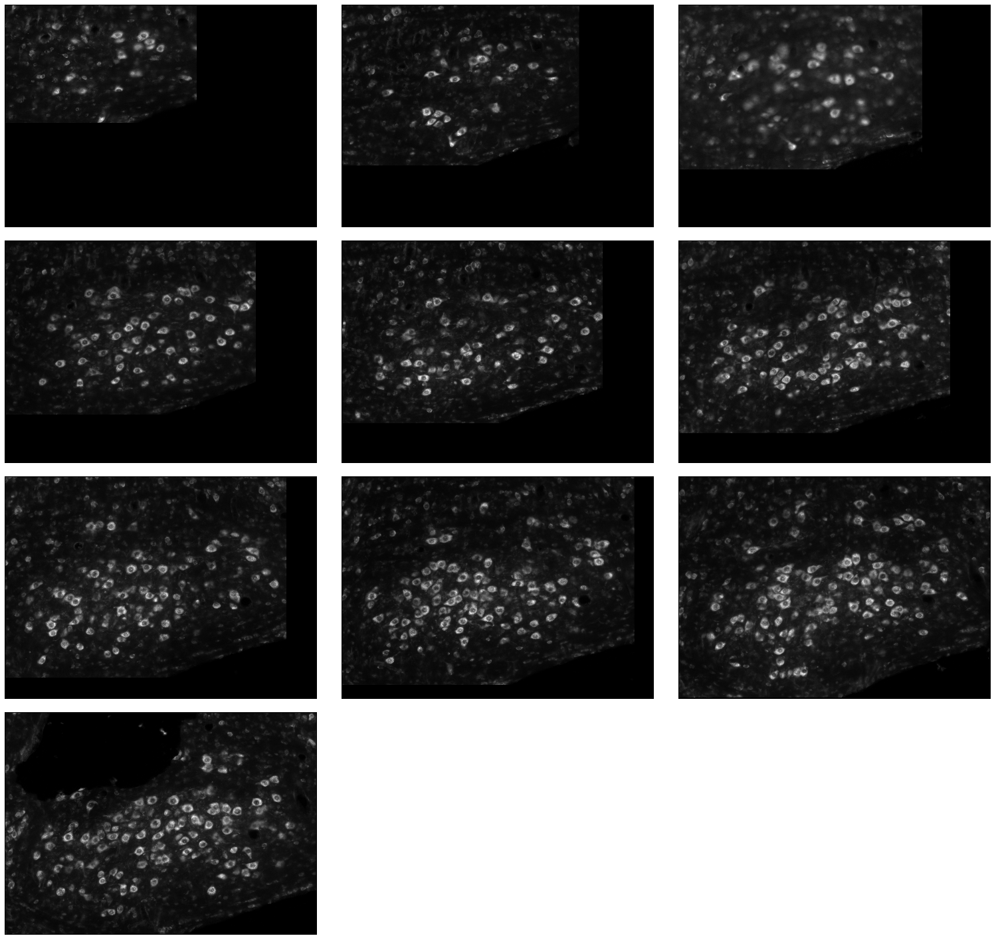

In [24]:
display_images_in_grids(local_region_images.values(), nc=3, cmap=plt.cm.gray, )

# Find the scaling between MD661 and ChatCryoJane201710

In [5]:
bbox = get_local_regions('MD661', by_human=True)['7N_L'][170]
img = DataManager.load_image_v2(stack='MD661', prep_id=2, section=170)[..., 2]
img1 = img[bbox[2]:bbox[3]+1, bbox[0]:bbox[1]+1].copy()

aws s3 cp --recursive "s3://mousebrainatlas-data/CSHL_labelings_v3/MD661" "/home/yuncong/CSHL_labelings_v3/MD661" --exclude "*" --include "*contours*"
latest timestamp:  12122017183504


Not using image_cache.


/media/yuncong/BstemAtlasData/CSHL_data_processed/MD661/MD661_prep2_lossless/MD662&661-F58-2017.06.06-02.35.45_MD661_2_0173_prep2_lossless.tif


In [6]:
bbox = get_local_regions('ChatCryoJane201710', by_human=True)['7N_L'][111]
img = DataManager.load_image_v2(stack='ChatCryoJane201710', prep_id=2, section=111, version='Ntb')
img2 = img[bbox[2]:bbox[3]+1, bbox[0]:bbox[1]+1].copy()

aws s3 cp --recursive "s3://mousebrainatlas-data/CSHL_labelings_v3/ChatCryoJane201710" "/home/yuncong/CSHL_labelings_v3/ChatCryoJane201710" --exclude "*" --include "*contours*"
latest timestamp:  12132017032001


Not using image_cache.


/media/yuncong/BstemAtlasData/CSHL_data_processed/ChatCryoJane201710/ChatCryoJane201710_prep2_lossless_Ntb/ChatCryoJane201710_slide37-S2_prep2_lossless_Ntb.tif


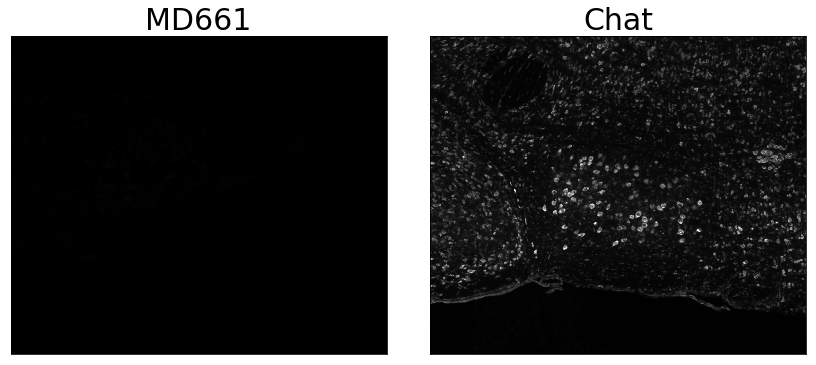

In [180]:
display_images_in_grids([img1, img2], nc=2, 
                        titles=['MD661', 'Chat'], vmin=0, vmax=65536, cmap=plt.cm.gray);

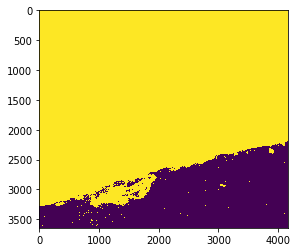

In [158]:
img1_mask = img1 > 10
plt.imshow(img1_mask);

min = 0 max = 2349


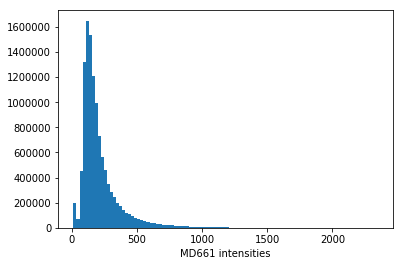

In [162]:
plt.hist(img1[img1_mask].flatten(), 100, log=False);
plt.xlabel('MD661 intensities');
print 'min =', img1.min(), 'max =', img1.max()

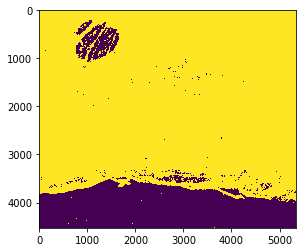

In [175]:
img2_mask = img2 > np.percentile(img2, 20)
plt.imshow(img2_mask);

min = 202 max = 65535


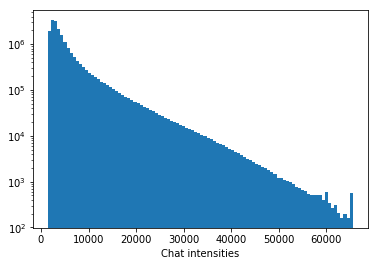

In [176]:
plt.hist(img2[img2_mask].flatten(), 100, log=True);
plt.xlabel('Chat intensities');
print 'min =', img2.min(), 'max =', img2.max()

slope = 38.73730760570282 intercept = -1902.342398083948


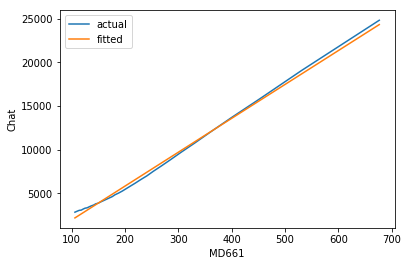

In [266]:
img1_intensities = np.percentile(img1[img1_mask], range(30, 100, 2))
img2_intensities = np.percentile(img2[img2_mask], range(30, 100, 2))

from scipy import stats
slope, intercept, r_value, p_value, std_err = stats.linregress(img1_intensities, img2_intensities)
fitted_intensities = img1_intensities * slope + intercept
print 'slope =', slope, 'intercept =', intercept

# from sklearn import linear_model
# ransac = linear_model.RANSACRegressor(min_samples=2)
# ransac.fit(img1_intensities[:,None], img2_intensities)
# inlier_mask = ransac.inlier_mask_
# outlier_mask = np.logical_not(inlier_mask)
# fitted_intensities = ransac.predict(img1_intensities[:,None])

plt.plot(img1_intensities, img2_intensities, label='actual');
plt.plot(img1_intensities, fitted_intensities, label='fitted');
plt.xlabel('MD661');
plt.ylabel('Chat');
plt.legend();
plt.show();

In [178]:
img1_stretched = np.maximum(np.minimum(img1 * slope + intercept, 65536), 0)

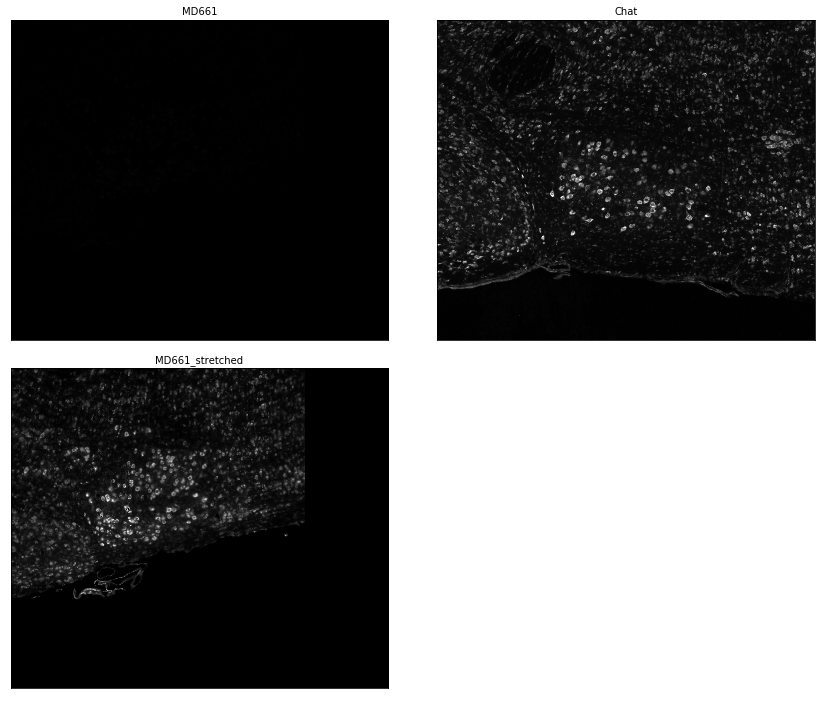

In [216]:
display_images_in_grids([img1, img2, img1_stretched], nc=2, 
                        titles=['MD661', 'Chat', 'MD661_stretched'], 
                        vmin=0, vmax=65536, cmap=plt.cm.gray);

# Convert both to CSHL Nissl

In [259]:
ntb_to_nissl = np.load(DataManager.get_ntb_to_nissl_intensity_profile_mapping_filepath())

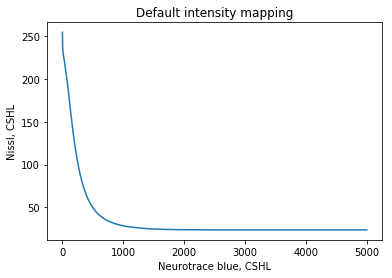

In [260]:
plt.plot(ntb_to_nissl);
plt.title('Default intensity mapping');
plt.xlabel('Neurotrace blue, CSHL');
plt.ylabel('Nissl, CSHL');

In [261]:
img1_in_CSHLNissl = ntb_to_nissl[img1]

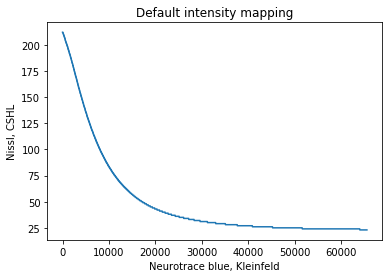

In [262]:
KleinfeldNtb_to_CSHLNissl = ntb_to_nissl[(np.maximum(np.minimum((np.arange(0, 65536) - intercept) / slope, 65536), 0)).astype(np.int)].astype(np.int)

kleinfeld_ntb_to_nissl_map_fp = DataManager.get_ntb_to_nissl_intensity_profile_mapping_filepath(stack='ChatCryoJane201710')
np.save(kleinfeld_ntb_to_nissl_map_fp, KleinfeldNtb_to_CSHLNissl)

plt.plot(KleinfeldNtb_to_CSHLNissl);
plt.title('Default intensity mapping');
plt.xlabel('Neurotrace blue, Kleinfeld');
plt.ylabel('Nissl, CSHL');

In [263]:
img2_in_CSHLNissl = KleinfeldNtb_to_CSHLNissl[img2.astype(np.uint)]

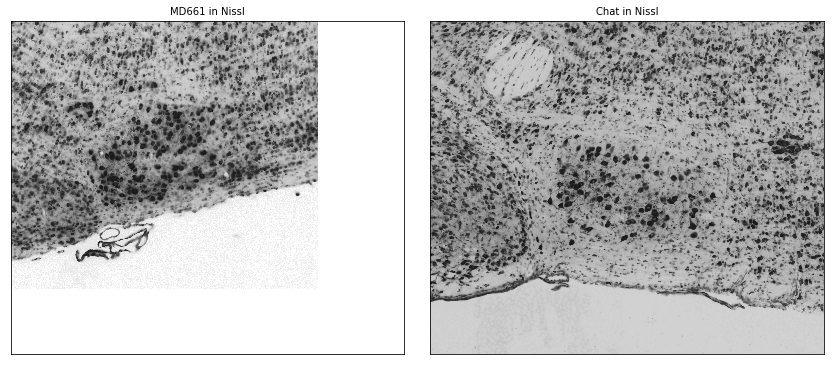

In [264]:
display_images_in_grids([img1_in_CSHLNissl, img2_in_CSHLNissl], nc=2, 
                        titles=['MD661 in Nissl', 'Chat in Nissl'], 
                        vmin=0, vmax=256, cmap=plt.cm.gray);

# Interpolate zero-mean unit-std scaling of moderately-sized regions

In [65]:
def is_on_mask(tb_mask, bbox):
    tb_region_xmin = bbox[0] / 32
    tb_region_xmax = bbox[1] / 32
    tb_region_ymin = bbox[2] / 32
    tb_region_ymax = bbox[3] / 32
    
    if tb_region_xmax > tb_mask.shape[1] or tb_region_ymax > tb_mask.shape[0]:
        return False

    if not np.all(np.r_[tb_mask[tb_region_ymin, tb_region_xmin],
        tb_mask[tb_region_ymin, tb_region_xmax],
        tb_mask[tb_region_ymax, tb_region_xmin],
        tb_mask[tb_region_ymax, tb_region_xmax]]):
        return False

    return True

In [66]:
stack = 'ChatCryoJane201710'

In [ ]:
for section in metadata_cache['valid_sections'][stack]:
    
    print section
    
    img = DataManager.load_image_v2(stack=stack, prep_id=2, section=section, version='Ntb')
    tb_mask = DataManager.load_thumbnail_mask_v3(stack=stack, prep_id=2, section=section)
    
    mean_std_all_regions = []
    cx_cy_all_regions = []
    # region_size = 4000
    # region_spacing = region_size/4
    region_size = 5000
    region_spacing = 1000
    for cx in range(region_size, img.shape[1]-region_size, region_spacing):
        for cy in range(region_size, img.shape[0]-region_size, region_spacing):
            if is_on_mask(tb_mask, (cx-region_size/2, cx+region_size/2+1, cy-region_size/2, cy+region_size/2+1)):
                reg = img[cy-region_size/2:cy+region_size/2+1, cx-region_size/2:cx+region_size/2+1]
                mean_std_all_regions.append((reg.mean(), reg.std()))
                cx_cy_all_regions.append((cx, cy))
                
    mean_map = resample_scoremap(np.array(mean_std_all_regions)[:,0], np.array(cx_cy_all_regions), 
                  img_shape=metadata_cache['image_shape']['ChatCryoJane201710'], 
                             downscale=32, out_dtype=np.float32,
                            half_size=region_size/2, spacing=region_spacing)
    
#     plt.figure(figsize=(10,10));
#     plt.imshow(mean_map);
#     plt.colorbar();

    std_map = resample_scoremap(np.array(mean_std_all_regions)[:,1], np.array(cx_cy_all_regions), 
                  img_shape=metadata_cache['image_shape']['ChatCryoJane201710'], 
                             downscale=32, out_dtype=np.float32,
                            half_size=region_size/2, spacing=region_spacing)
    
#     plt.figure(figsize=(10,10));
#     plt.imshow(std_map);
#     plt.colorbar();

    mean_std_sample_locations = \
    {(x,y): (mean_map[y/32, x/32], std_map[y/32, x/32])
     for x,y in grid_parameters_to_sample_locations(win_id_to_gridspec(win_id=5, stack=stack))}
    
    save_pickle(mean_std_sample_locations, ROOT_DIR + 'sample_locations_mean_std/%s_%d_sample_locations_mean_std.pkl' % (stack, section))

1


Not using image_cache.


2


Not using image_cache.


3


Not using image_cache.


4


Not using image_cache.


In [ ]:
def normalize_image(img):
    
    img_calib = np.zeros(img.shape, np.float)

    region_size = 5000
    region_spacing = 1000
    for cx in range(region_size, img.shape[1]-region_size, region_spacing):
        for cy in range(region_size, img.shape[0]-region_size, region_spacing):
    #         mu, std = mean_std_sample_locations[(cx, cy)]
            mu = img[cy-region_size/2:cy+region_size/2+1, cx-region_size/2:cx+region_size/2+1].mean()
            std = img[cy-region_size/2:cy+region_size/2+1, cx-region_size/2:cx+region_size/2+1].std()
            if std > 0:            
    #             img_calib[cy-region_size/2:cy+region_size/2+1, cx-region_size/2:cx+region_size/2+1] = \
    #             .5 * img_calib[cy-region_size/2:cy+region_size/2+1, cx-region_size/2:cx+region_size/2+1] + \
    #             .5 * (img[cy-region_size/2:cy+region_size/2+1, cx-region_size/2:cx+region_size/2+1] - mu) / std

                img_calib[cy-region_size/2:cy+region_size/2+1, cx-region_size/2:cx+region_size/2+1] = \
                (img[cy-region_size/2:cy+region_size/2+1, cx-region_size/2:cx+region_size/2+1] - mu) / std
    return img_calib

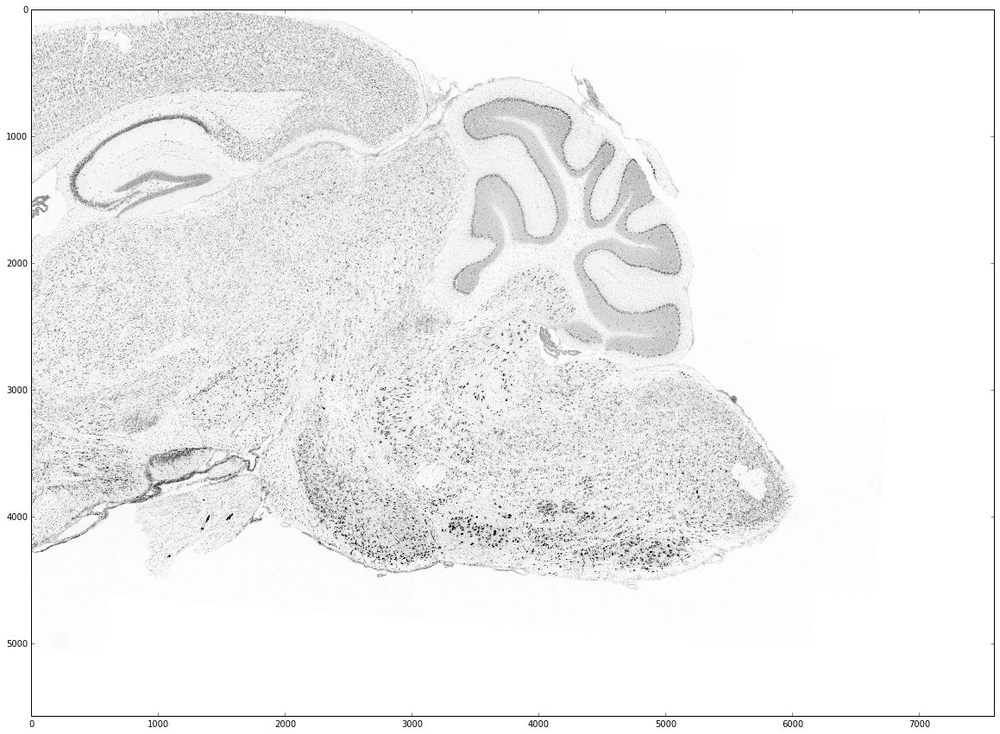

In [14]:
plt.figure(figsize=(20,20));
plt.imshow(rescale_intensity_v2(img[::4, ::4], img[::4, ::4].max(), img[::4, ::4].min()), 
           cmap=plt.cm.gray, vmin=0, vmax=255);

In [ ]:
img_calib = normalize_image(img)

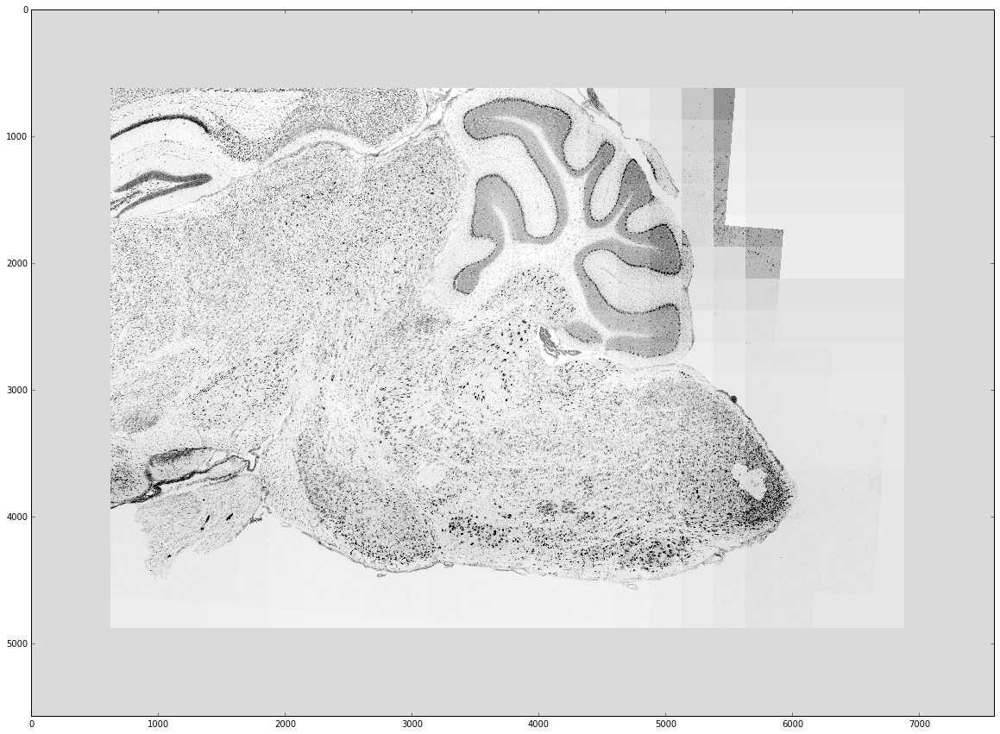

In [48]:
img_calib_ubyte = rescale_intensity_v2(img_calib[::4,::4], 6, -1)

plt.figure(figsize=(20,20));
plt.imshow(img_calib_ubyte, cmap=plt.cm.gray, vmin=0, vmax=255);

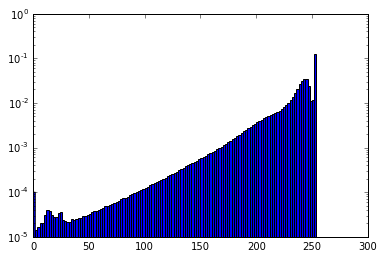

In [32]:
plt.hist(rescale_intensity_v2(img[::4, ::4], img[::4, ::4].max(), img[::4, ::4].min()).flatten(), 
          bins=np.arange(0, 256, 2), normed=True, log=True);

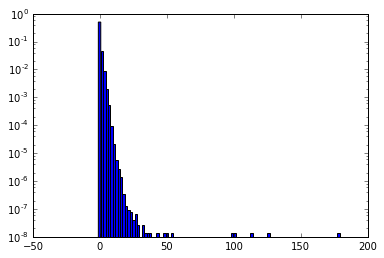

In [25]:
plt.hist(img_calib[::4,::4].flatten(), bins=100, normed=True, log=True);

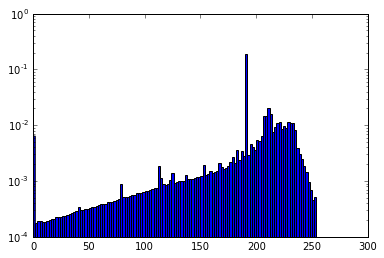

In [35]:
plt.hist(rescale_intensity_v2(img_calib[::4,::4], 3, -1).flatten(), 
         bins=np.arange(0, 256, 2), normed=True, log=True);

# Extract Local regions

In [4]:
stack = 'MD661'
# stack = 'ChatCryoJane201710'

In [5]:
windowing_id = 5

windowing_properties = windowing_settings[windowing_id]
patch_size = windowing_properties['patch_size']
spacing = windowing_properties['spacing']
w, h = metadata_cache['image_shape'][stack]
half_size = patch_size/2

grid_spec = (patch_size, spacing, w, h)

sample_locations_ = grid_parameters_to_sample_locations(grid_spec=grid_spec)

In [6]:
contours_df = DataManager.load_annotation_v4(stack=stack, by_human=True, suffix='contours', timestamp='latest')
contours = contours_df[(contours_df['orientation'] == 'sagittal') & (contours_df['downsample'] == 1)]
# contours = contours.drop_duplicates(subset=['section', 'name', 'side', 'filename', 'downsample', 'creator'])
contours = contours.drop_duplicates(subset=['section', 'name', 'side', 'downsample', 'creator'])

aws s3 cp --recursive "s3://mousebrainatlas-data/CSHL_labelings_v3/MD661" "/home/yuncong/CSHL_labelings_v3/MD661" --exclude "*" --include "*contours*"
latest timestamp:  08022017175151


In [7]:
contours_df = convert_annotation_v3_original_to_aligned_cropped(contours, stack=stack, out_downsample=1)

download_from_s3(DataManager.get_thumbnail_mask_dir_v3(stack=stack, prep_id=2), is_dir=True)
contours_grouped = contours_df.groupby('section')

In [8]:
# Get bounding boxes for every structure on every section.

margin_um = 500

local_region_bboxes_allStructures_allSections = {structure: {} for structure in all_known_structures_sided}
for structure in all_known_structures_sided:
    name, side = parse_label(structure)[:2]
    if side is None:
        side = 'S'
    margin_pixel = margin_um / XY_PIXEL_DISTANCE_LOSSLESS
    q = contours_df[(contours_df['name'] == name) & (contours_df['side'] == side)]
    for cnt_id, cnt in q.iterrows():
        vs = cnt['vertices']
        xmin, ymin = vs.min(axis=0) 
        xmax, ymax = vs.max(axis=0)
        local_region_bboxes_allStructures_allSections[structure][cnt['section']] = (max(0, int(np.floor(xmin-margin_pixel))),
                                            min(w-1, int(np.ceil(xmax+margin_pixel))),
                                            max(0, int(np.floor(ymin-margin_pixel))),
                                            min(h-1, int(np.ceil(ymax+margin_pixel))))

In [9]:
local_region_bboxes_allStructures_allSections

{'10N_L': {209: (10802, 14726, 6231, 9058),
  214: (10932, 15346, 6449, 9253),
  215: (11024, 15424, 6372, 9268),
  235: (10746, 15640, 6472, 9458),
  239: (10540, 15263, 6374, 9253),
  241: (10593, 15052, 6405, 9277),
  245: (11309, 15346, 6635, 9118),
  249: (11349, 14551, 6671, 9126)},
 '10N_R': {},
 '12N': {209: (10742, 14549, 6709, 9677),
  214: (10721, 15323, 6709, 9892),
  215: (10798, 15456, 6693, 9930),
  220: (10321, 15495, 6824, 9948),
  225: (10774, 15394, 7114, 10010),
  230: (10720, 15313, 6810, 10029),
  235: (10719, 15443, 6785, 9987),
  239: (10566, 15399, 6776, 9917),
  241: (10884, 15318, 6876, 9868)},
 '3N_L': {},
 '3N_R': {},
 '4N_L': {},
 '4N_R': {},
 '5N_L': {138: (5539, 8728, 6995, 11119),
  145: (5782, 9236, 6914, 11561),
  152: (5766, 9546, 6911, 11253),
  273: (6198, 8980, 7262, 10437),
  275: (6140, 9344, 7194, 11132),
  282: (5562, 9203, 7310, 11544),
  290: (5586, 8853, 7277, 11209)},
 '5N_R': {},
 '6N_L': {199: (7450, 10118, 7622, 10326),
  200: (7426, 10

# Test Yoav's normalization idea
Using regions around a given landmark. Goal is to see if such normalization makes the brightness similar.

In [52]:
structure_to_inspect = 'SNR_L'

In [86]:
from distributed_utilities import *

In [96]:
img_blue_local_region_allSections = {}

for sec, (roi_xmin, roi_xmax, roi_ymin, roi_ymax) in local_region_bboxes_allStructures_allSections[structure_to_inspect].items():
    roi_w = roi_xmax + 1 - roi_xmin
    roi_h = roi_ymax + 1 - roi_ymin
    
#     img_blue_fp = DataManager.get_image_filepath_v2(stack=stack, section=sec, prep_id=2, resol='lossless', version='Ntb')
    
    img_blue_fp = DataManager.get_image_filepath_v2(stack=stack, section=sec, prep_id=2, resol='lossless')
    download_from_s3(img_blue_fp)
    
    img_blue_local_region_allSections[sec] = crop_large_image(fp=img_blue_fp, bbox=(roi_xmin-666,roi_xmax+666,roi_ymin-666,roi_ymax+666))[...,2]

convert "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD661/MD661_prep2_lossless/MD662&661-F55-2017.06.22-17.33.34_MD661_1_0163_prep2_lossless.tif" -crop 5854x6500+1127+5843 /tmp/tmp.tif
convert "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD661/MD661_prep2_lossless/MD662&661-F114-2017.06.07-03.45.47_MD661_1_0340_prep2_lossless.tif" -crop 5698x6117+786+6058 /tmp/tmp.tif
rm -rf "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD661/MD661_prep2_lossless/MD662&661-F45-2017.06.05-22.05.50_MD661_1_0133_prep2_lossless.tif" && mkdir -p "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD661/MD661_prep2_lossless"
aws s3 cp "s3://mousebrainatlas-data/CSHL_data_processed/MD661/MD661_prep2_lossless/MD662&661-F45-2017.06.05-22.05.50_MD661_1_0133_prep2_lossless.tif" "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD661/MD661_prep2_lossless/MD662&661-F45-2017.06.05-22.05.50_MD661_1_0133_prep2_lossless.tif"
convert "/media/yuncong/BstemAtlasData/CSHL_data_processed/MD661/MD661_prep2_

In [97]:
titles = ["sec=%d"%sec for sec, im in sorted(img_blue_local_region_allSections.items())]
imgs = [im for sec, im in sorted(img_blue_local_region_allSections.items())]

In [98]:
img_normalized_local_region_allSections = {sec: (im - im.mean()) / im.std() 
                                           for sec, im in img_blue_local_region_allSections.iteritems()}

In [99]:
imgs_normalized = [im for sec, im in sorted(img_normalized_local_region_allSections.items())]

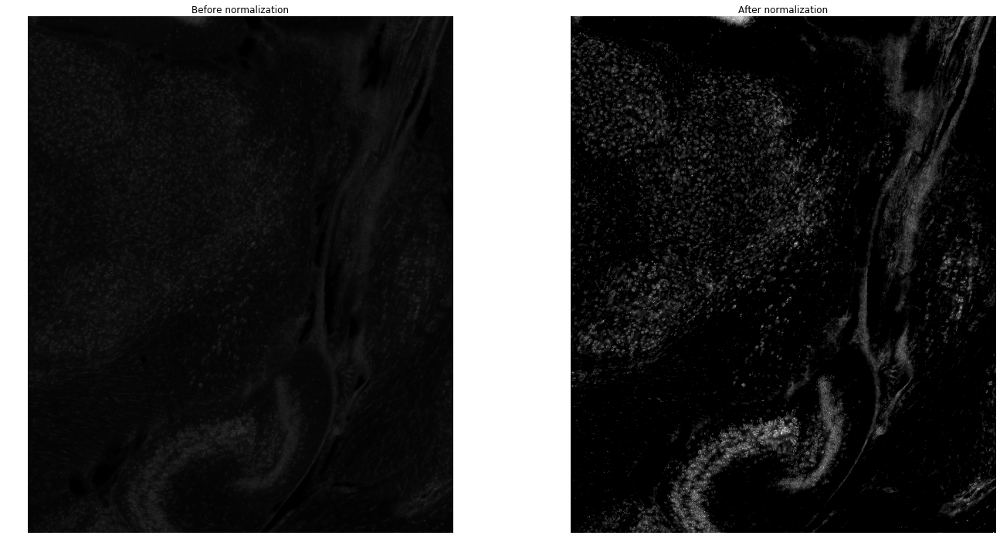

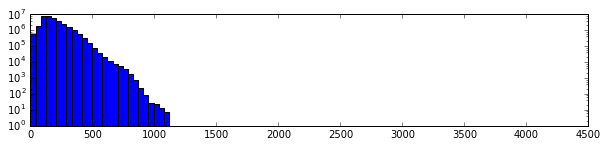

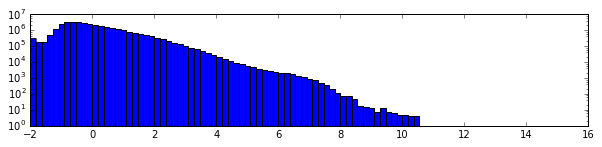

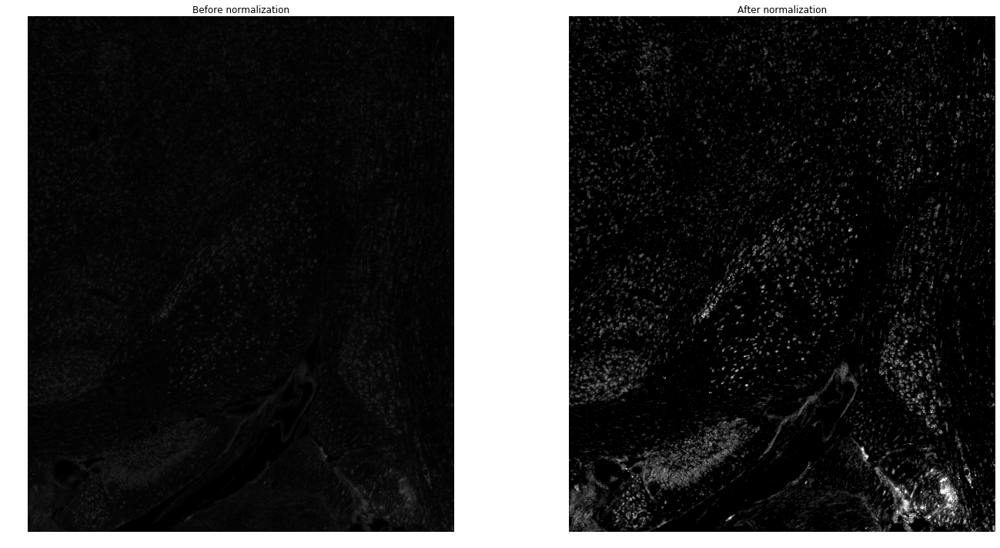

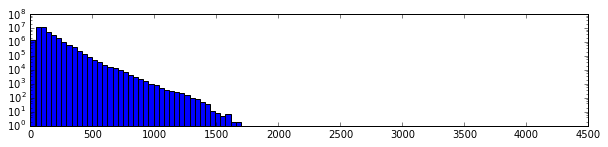

...

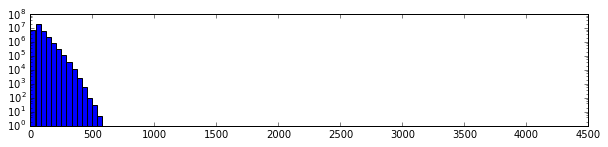

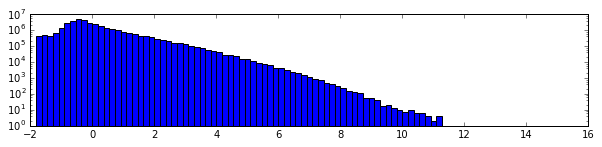

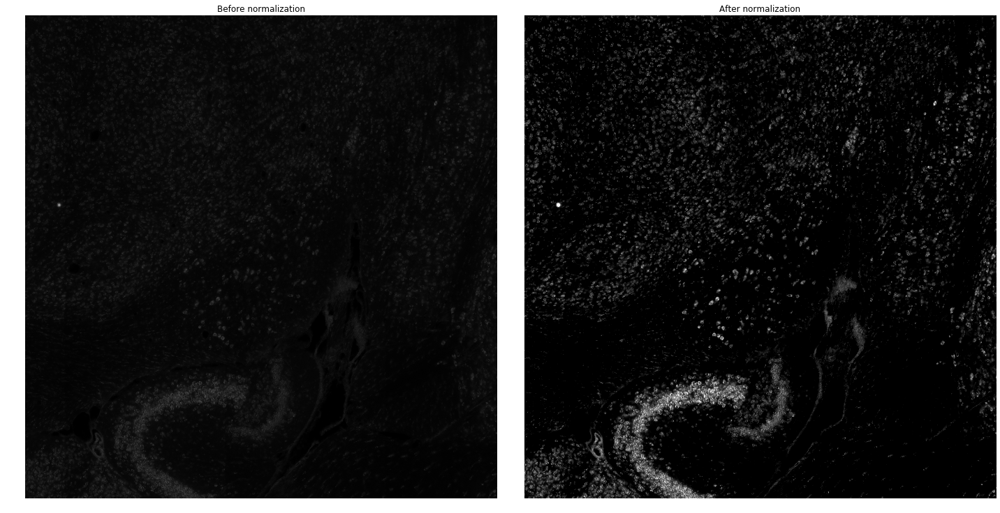

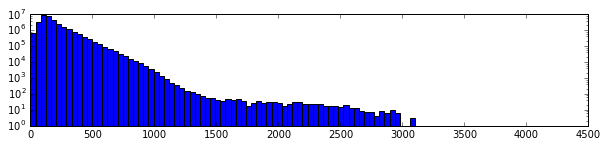

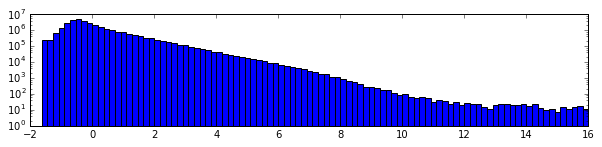

In [104]:
# from mpl_toolkits.axes_grid1 import make_axes_locatable

for im in imgs[::3]:
#     plt.figure(figsize=(10, 10))
    fig, axes = plt.subplots(1, 2, figsize=(20, 10))
#     plt.imshow(im, vmin=0, vmax=65535, cmap=plt.cm.gray)
    
    ax = axes[0]
    ax.imshow(im, vmin=0, vmax=2**12, cmap=plt.cm.gray)
#     divider = make_axes_locatable(ax)
#     cax = divider.append_axes("right", size="5%", pad=0.05)
#     plt.colorbar(im, cax=cax)
    ax.set_axis_off()
    ax.set_title('Before normalization')
    
    mu = im.mean()
    sigma = im.std()
    im_normalized = (im-mu)/sigma
    
#     ax = plt.gca()
    ax = axes[1]
    ax.imshow(im_normalized, vmin=0, vmax=9, cmap=plt.cm.gray)
#     im = ax.imshow(im_normalized, vmin=0, vmax=9, cmap=plt.cm.gray)
#     divider = make_axes_locatable(ax)
#     cax = divider.append_axes("right", size="5%", pad=0.05)
#     plt.colorbar(im, cax=cax)
    
    ax.set_axis_off()
    ax.set_title('After normalization')
    
    plt.tight_layout();
    plt.show()
    
    #######################
    
    plt.figure(figsize=(10,2))
    plt.hist(im.flatten(), bins=np.linspace(0, 2**12, 100), log=True);
    plt.show()
    
    plt.figure(figsize=(10,2))
    plt.hist(im_normalized.flatten(), bins=np.linspace(-2, 16, 100), log=True);
    plt.show()

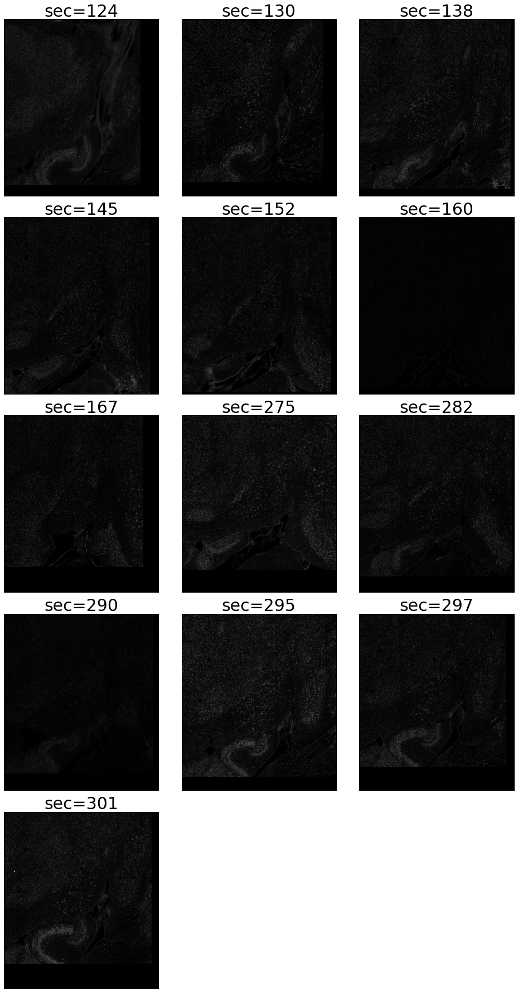

In [105]:
display_images_in_grids(imgs, nc=3, titles=titles, vmin=0, vmax=3000, cmap=plt.cm.gray)

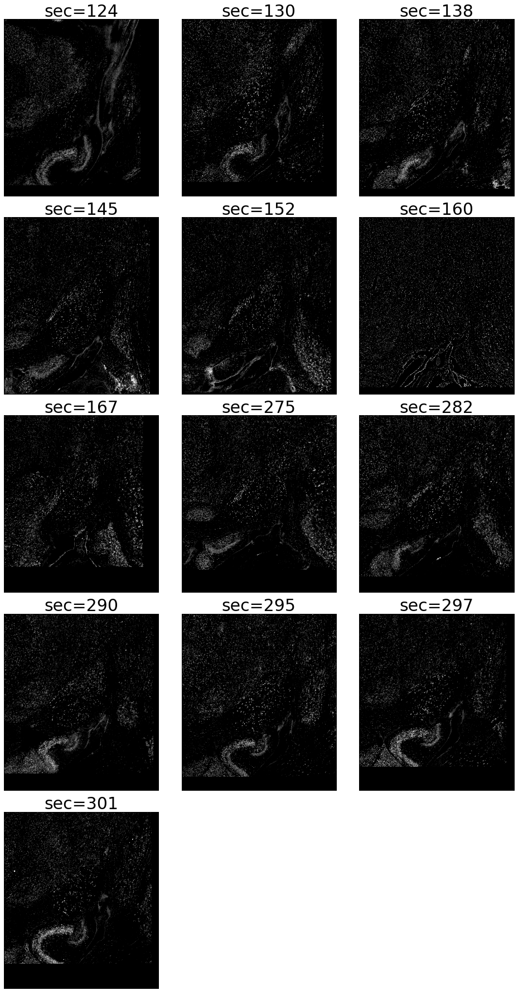

In [106]:
display_images_in_grids(imgs_normalized, nc=3, titles=titles, vmin=0, vmax=9, cmap=plt.cm.gray)

-176.273724211 341.238102478


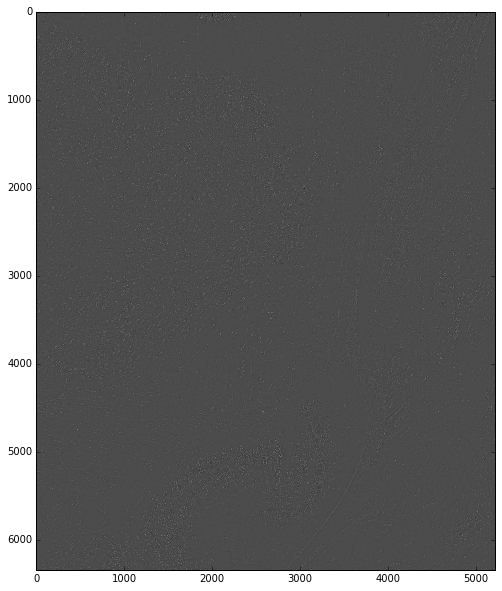

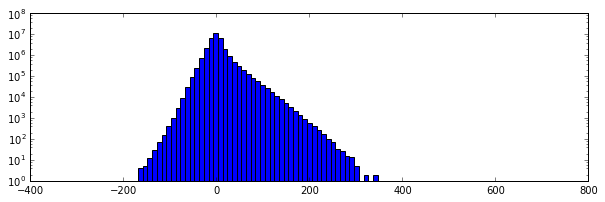

-269.980459057 568.999866953


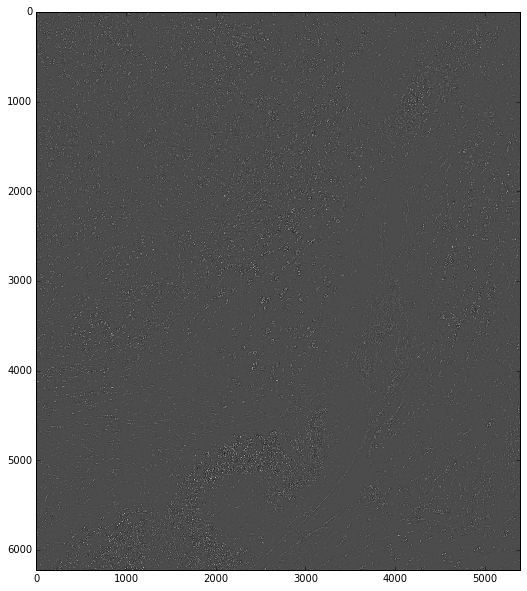

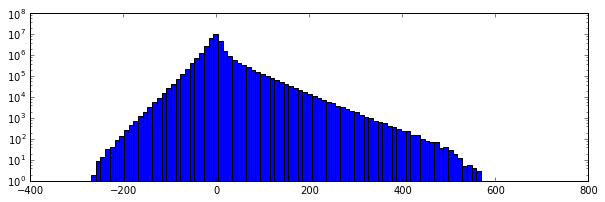

-237.57541396 536.193995029


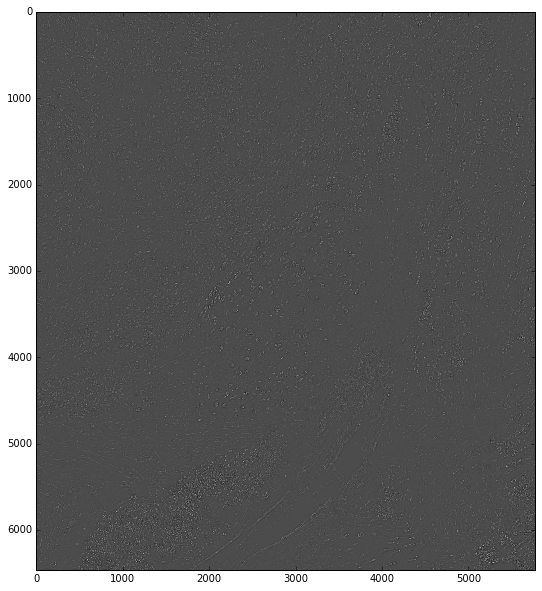

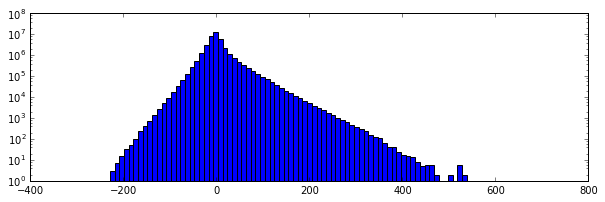

-204.902128513 636.846345279


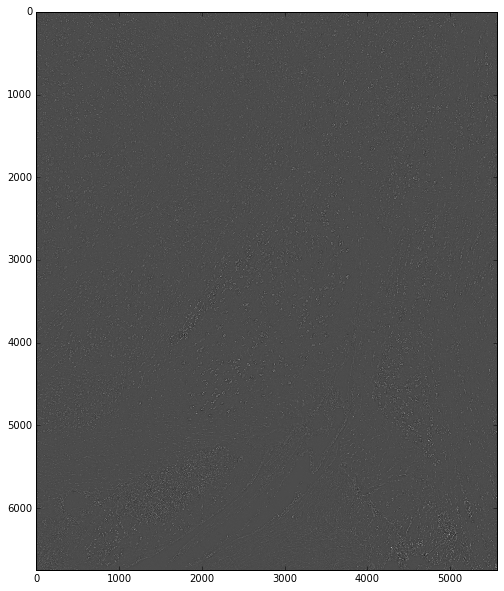

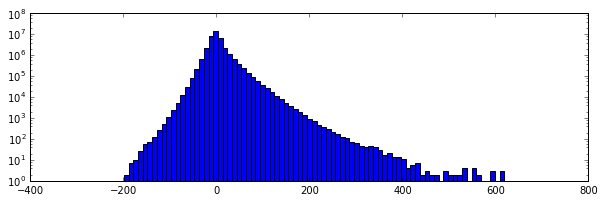

-253.608969954 656.14081565


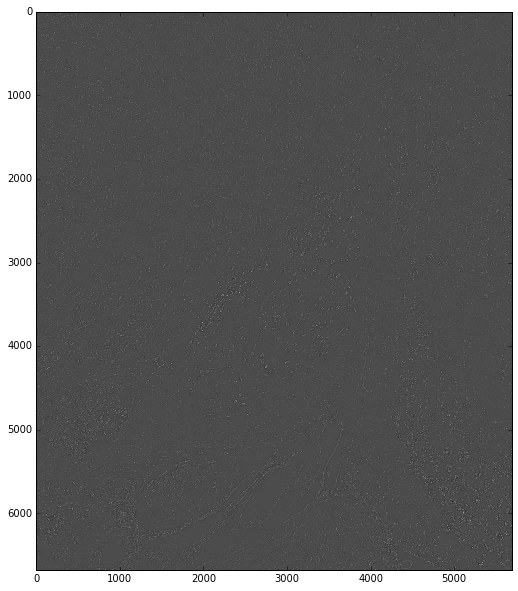

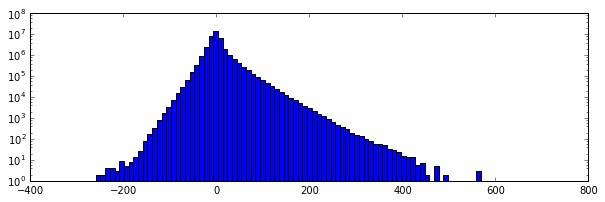

-117.745494965 278.539574871


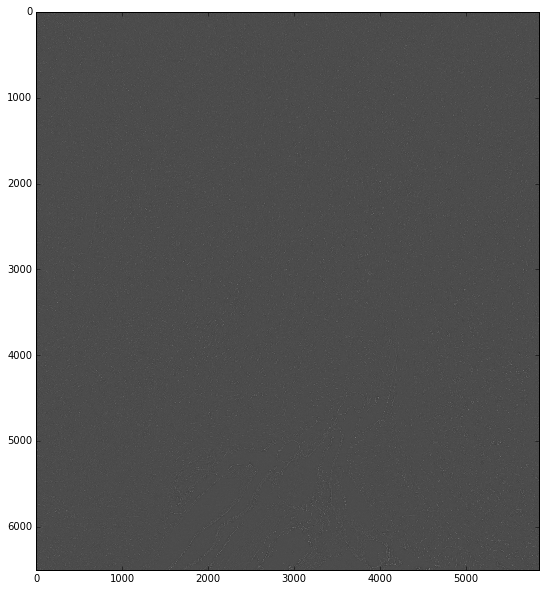

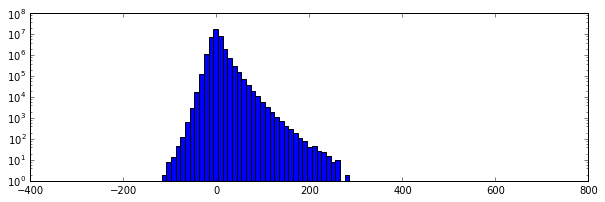

-204.562843812 468.884860779


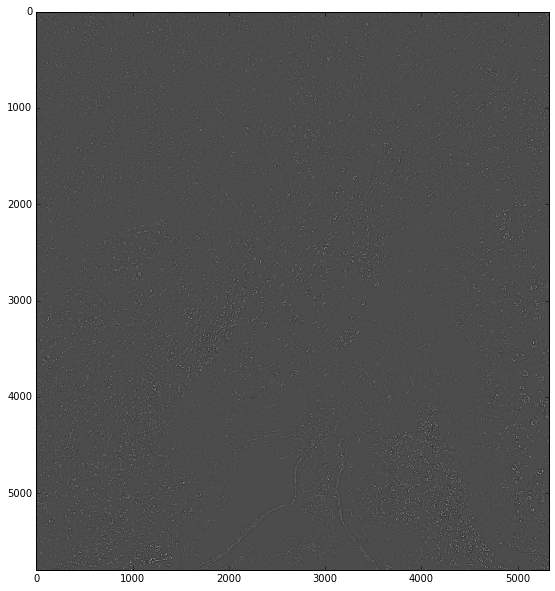

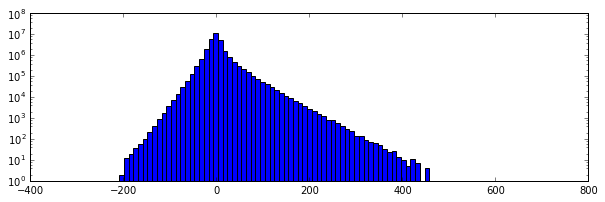

-228.991064045 707.695554317


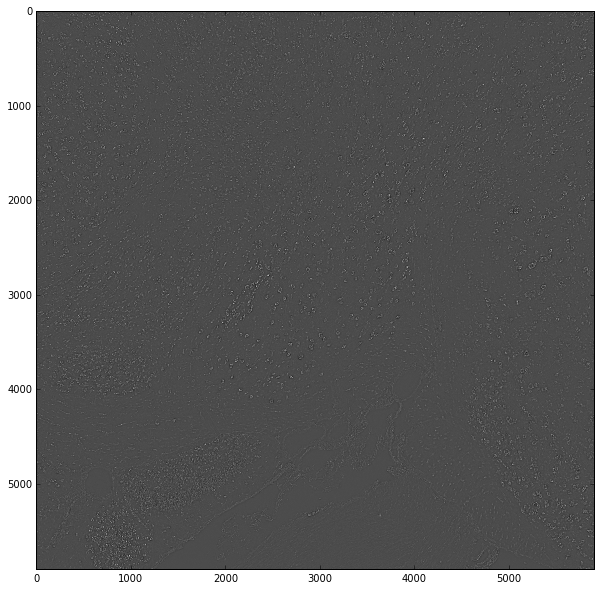

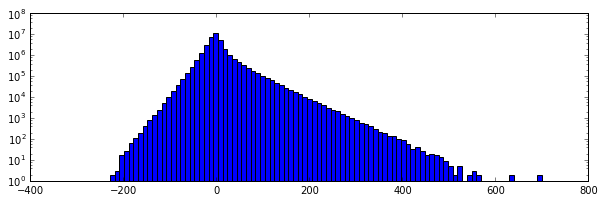

-179.352548576 594.135284067


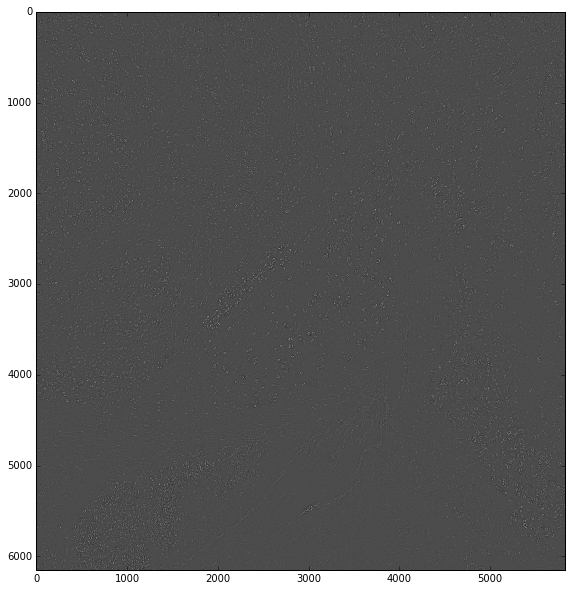

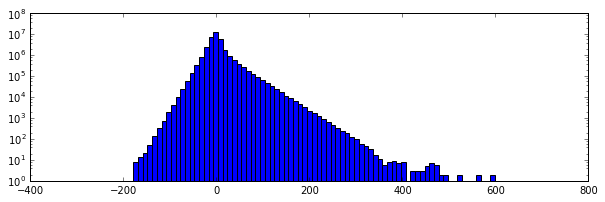

-91.0872815877 171.128922067


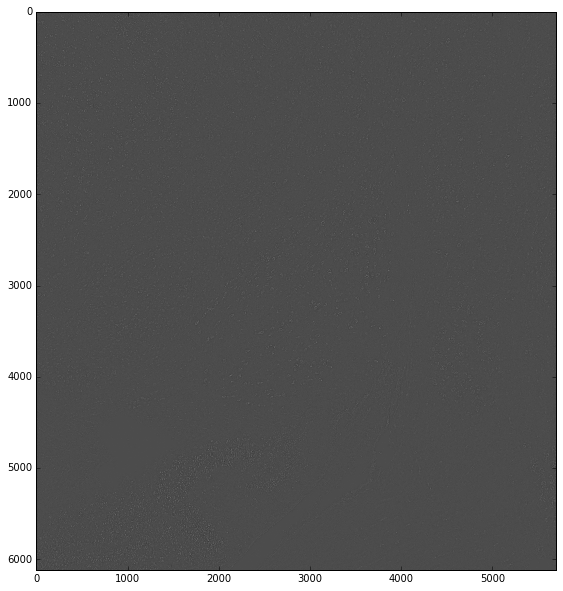

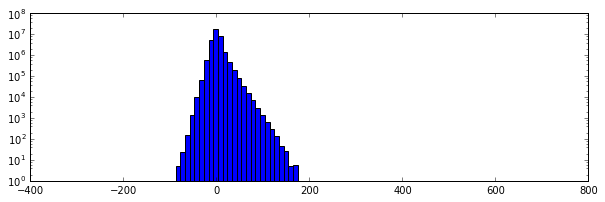

-285.913966995 538.834446663


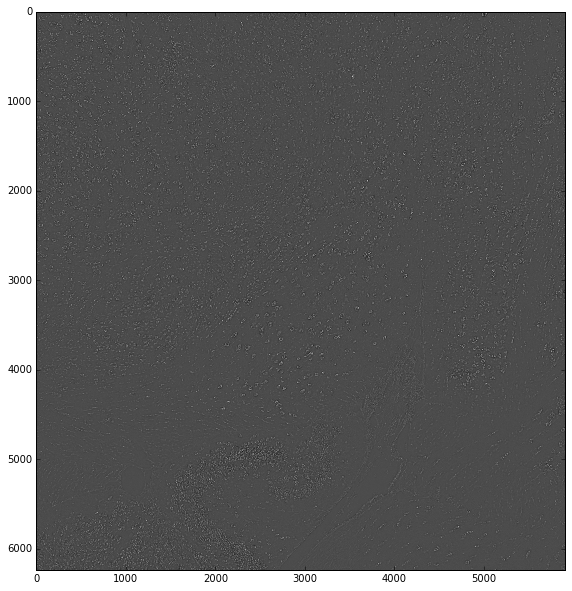

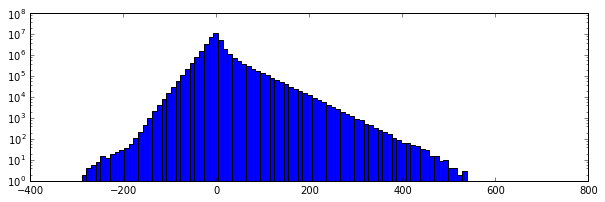

-192.393627485 444.333292978


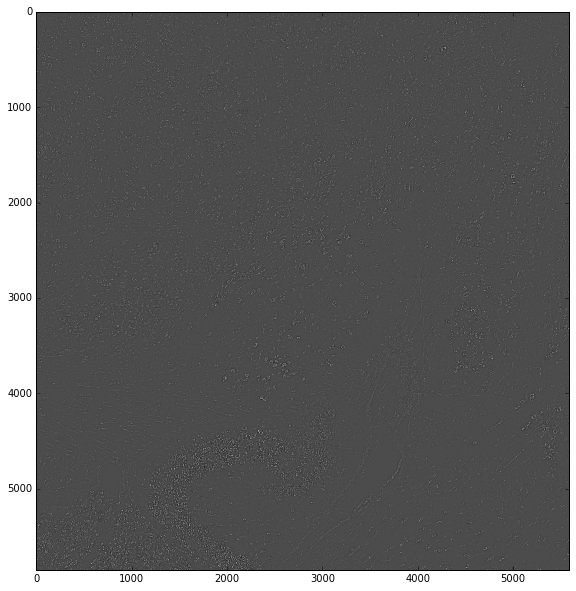

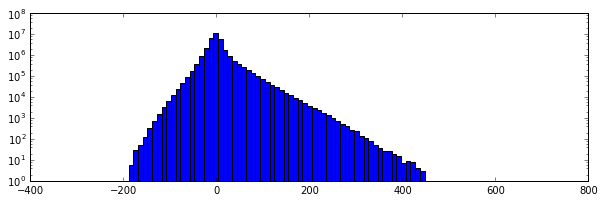

-273.161219243 709.151773436


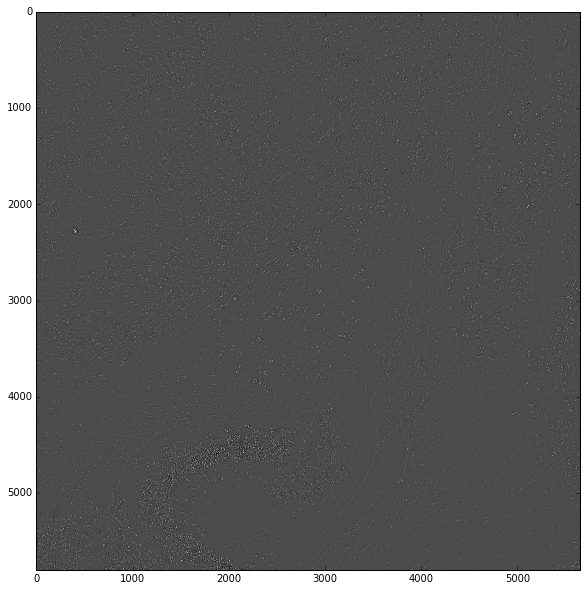

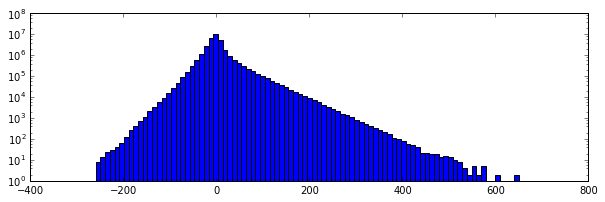

In [126]:
for img in imgs:
    
    lowpass = gaussian(img.astype(np.float), 5)
    gauss_highpass = img - lowpass

    print gauss_highpass.min(), gauss_highpass.max()
    
    plt.figure(figsize=(10, 10));
    plt.imshow(gauss_highpass, vmin=-300, vmax=700, cmap=plt.cm.gray);
    plt.axis('equal');
    plt.show();
    
    plt.figure(figsize=(10, 3));
    plt.hist(gauss_highpass.flatten(), bins=np.linspace(-300,700,100), log=True);
    plt.show();